<div style="color:white;display:fill;border-radius:8px;
            background-color:#a7d5ed;font-size:170%;
            font-family:Nexa;letter-spacing:4.5px;">    
    <h1 style="padding:15px;color:black;text-align: center"> Ponto de partida (EDA) </h1> 
</div>

![](img/header.png?t=2021-04-09-00-57-05)

<div style="color:white;border-radius:8px;background-color:#a7d5ed">    
    <h1 style="padding:12px;color:black;"> OBJETIVO </h1>    
</div>

Neste notebook vamos fazer uma análise (EDA) para conhencer os dados e estabelecer uma linha de base, mostrarei as etapas iniciais de uma competição da Flai - da compreensão do conjunto de dados até a preparação para serem usados em um modelo machine learning, vamos passar pelas seguintes etapas:

- Leitura no conjunto de dados;
- Calculando estatísticas sobre o conjunto de dados;
- Visualização univariada;
- Visualizando multivariada;
- Pré-processamento;
- Modelagem.

<font color=green> <b>Definição do Problema</b> </font>

Objetivo da Competição é prever o resultado de vendadas de televendas, isto é, se uma vendas será realizada ou não, a métrica de avaliação é <b> F1-score. <p>

<div align='center'> <font size="4">
$$ F1= 2*\frac{precision*recall}{precision+recall}$$    
</font>
</div>
    

<p style="border-bottom: 2px solid #256B5D"/>

<div style="color:white;border-radius:8px;background-color:#a7d5ed">    
    <h1 style="padding:12px;color:black;"> 1. IMPORTAÇÕES </h1>    
</div>

## 1.1. Instalações

In [1]:
COLAB = 'google.colab' in str(get_ipython()) 

if COLAB:        
    !pip install --q scikit-plot
    !pip install --q category_encoders
    !pip install --q shap
    !pip install --q inflection    
    !pip install --q catboost
    !pip install --q colorama
    !pip install --q tensorflow
    !pip install --q wandb
    !pip install --q eli5
    #!pip install --q optbinning
    #!pip install --q catboost
    #!pip install --q pandas-profiling
    #!pip install --q pycaret
        
    from google.colab import drive
    drive.mount('/content/drive')

## 1.2. Bibliotecas 

In [975]:
import warnings
import random
import os
import gc
import torch
import sklearn.exceptions
import shap
import multiprocessing
import glob
import scipy.optimize 
import scipy.special

In [976]:
import pandas            as pd
import numpy             as np
import matplotlib.pyplot as plt 
import seaborn           as sns
import joblib            as jb
import xgboost           as xgb
import scipy.stats       as stats
import statsmodels.api   as sm

In [977]:
from matplotlib.axes._axes   import _log as matplotlib_axes_logger
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold, StratifiedShuffleSplit
from sklearn.preprocessing   import StandardScaler, MinMaxScaler, RobustScaler 
from sklearn.preprocessing   import MaxAbsScaler, QuantileTransformer 
from sklearn.preprocessing   import PowerTransformer, Normalizer
from sklearn.preprocessing   import LabelBinarizer, OneHotEncoder, OrdinalEncoder
from sklearn                 import metrics
from sklearn.metrics         import make_scorer

In [1100]:
from datetime                import datetime
from scipy.stats             import skew, norm
from collections             import Counter
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.calibration       import CalibrationDisplay

In [980]:
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import fbeta_score
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss

***

## 1.3. Funções
Aqui centralizamos todas as funções desenvolvidas durante o projeto para melhor organização do código.

In [6]:
class Utility():
        
    def __init__(self):
        self.name_ =''
       
    def jupyter_setting():
    
        %matplotlib inline

        #os.environ["WANDB_SILENT"] = "true" 
        #plt.style.use('bmh') 
        #plt.rcParams['figure.figsize'] = [20,15]
        #plt.rcParams['font.size']      = 13

        matplotlib_axes_logger.setLevel('ERROR')

        pd.options.display.max_columns = None
        #pd.set_option('display.expand_frame_repr', False)

        warnings.filterwarnings(action='ignore')
        warnings.simplefilter('ignore')
        warnings.filterwarnings('ignore')
        warnings.filterwarnings('ignore', category=DeprecationWarning)
        warnings.filterwarnings('ignore', category=FutureWarning)
        warnings.filterwarnings('ignore', category=RuntimeWarning)
        warnings.filterwarnings('ignore', category=UserWarning)
        warnings.filterwarnings("ignore", category=sklearn.exceptions.UndefinedMetricWarning)
        warnings.filterwarnings("ignore", category= sklearn.exceptions.UndefinedMetricWarning)
        warnings.simplefilter(action="ignore", category=pd.errors.PerformanceWarning)

        pd.options.mode.chained_assignment = None 
        pd.set_option('display.max_rows', 200)
        pd.set_option('display.max_columns', 500)
        pd.set_option('display.max_colwidth', 200)

        icecream = ["#00008b", "#960018","#008b00", "#00468b", "#8b4500", "#582c00"]
        #sns.palplot(sns.color_palette(icecream))

        colors = ["lightcoral", "sandybrown", "darkorange", "mediumseagreen",
              "lightseagreen", "cornflowerblue", "mediumpurple", "palevioletred",
              "lightskyblue", "sandybrown", "yellowgreen", "indianred",
              "lightsteelblue", "mediumorchid", "deepskyblue"]

        # Colors
        dark_red   = "#b20710"
        black      = "#221f1f"
        green      = "#009473"
        myred      = '#CD5C5C'
        myblue     = '#6495ED'
        mygreen    = '#90EE90'    
        color_cols = [myred, myblue,mygreen]

        return icecream, colors, color_cols

    def missing_zero_values_table(self, df):
        
        mis_val         = df.isnull().sum()
        mis_val_percent = round(df.isnull().mean().mul(100), 2)
        mz_table        = pd.concat([mis_val, mis_val_percent], axis=1)
        mz_table        = mz_table.rename(columns = {df.index.name:'col_name', 
                                                     0 : 'Valores ausentes', 
                                                     1 : '% de valores totais'})
        
        mz_table['Tipo de dados'] = df.dtypes
        mz_table                  = mz_table[mz_table.iloc[:,1] != 0 ]. \
                                     sort_values('% de valores totais', ascending=False)
        
        msg = "Seu dataframe selecionado tem {} colunas e {} " + \
              "linhas. \nExistem {} colunas com valores ausentes."
            
        print (msg.format(df.shape[1], df.shape[0], mz_table.shape[0]))
        
        return mz_table.reset_index()
    
    def reduce_memory_usage(self, df, verbose=True):
    
        numerics = ["int8", "int16", "int32", "int64", "float16", "float32", "float64"]
        start_mem = df.memory_usage().sum() / 1024 ** 2

        for col in df.columns:

            col_type = df[col].dtypes

            if col_type in numerics:
                c_min = df[col].min()
                c_max = df[col].max()

                if str(col_type)[:3] == "int":
                    if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                        df[col] = df[col].astype(np.int8)
                    elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                        df[col] = df[col].astype(np.int16)
                    elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                        df[col] = df[col].astype(np.int32)
                    elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                        df[col] = df[col].astype(np.int64)
                else:
                    if (
                        c_min > np.finfo(np.float16).min
                        and c_max < np.finfo(np.float16).max
                    ):
                        df[col] = df[col].astype(np.float16)
                    elif (
                        c_min > np.finfo(np.float32).min
                        and c_max < np.finfo(np.float32).max
                    ):
                        df[col] = df[col].astype(np.float32)
                    else:
                        df[col] = df[col].astype(np.float64)
        end_mem = df.memory_usage().sum() / 1024 ** 2
        if verbose:
            print(
                "Mem. usage decreased to {:.2f} Mb ({:.1f}% reduction)".format(
                    end_mem, 100 * (start_mem - end_mem) / start_mem
                )
            )

        return df
    
    def graf_label(self, ax, total):

         for i in ax.patches:
            # get_width pulls left or right; get_y pushes up or down
            width, height = i.get_width() -.2 , i.get_height()

            x, y  = i.get_xy()  
            color = 'white'
            alt   = .5
            soma  = 0 

            if height < 70:
                color = 'black'
                alt   = 1
                soma  = 10

            ax.annotate(str(round((i.get_height() * 100.0 / total), 1) )+'%', 
                        (i.get_x()+.55*width, 
                         i.get_y()+soma + alt*height),
                         color   = color,
                         weight = 'bold',
                         size   = 14)
            
    def graf_bar(self, df, col, title, xlabel, ylabel, tol = 0):
    
        #ax    = df.groupby(['churn_cat'])['churn_cat'].count()
        ax     = df    
        colors = col

        if tol == 0: 
            total  = sum(ax)
            ax = (ax).plot(kind    ='bar',
                           stacked = True,
                           width   = .5,
                           rot     = 0,
                           color   = colors, 
                           grid    = False)
        else:
            total  = tol     
            ax = (ax).plot(kind    ='bar',
                           stacked = True,
                           width   = .5,
                           rot     = 0,
                           figsize = (10,6),
                           color   = colors,
                           grid    = False)

        title   = title #+ ' \n'
        xlabel  = '\n ' + xlabel 
        ylabel  = ylabel + ' \n'

        ax.set_title(title  , fontsize=22)
        ax.set_xlabel(xlabel, fontsize=12)
        ax.set_ylabel(ylabel, fontsize=12)    

        min = [0,23000000]
        #ax.set_ylim(min)
        self.graf_label(ax, total)

    def correlation(self, df_, threshold_):
        col_corr    = set()  
        corr_matrix = df_.corr()
        
        for i in range(len(corr_matrix.columns)):
            for j in range(i):
                if abs(corr_matrix.iloc[i, j]) > threshold_: 
                    colname = corr_matrix.columns[i]  
                    col_corr.add(colname)
                    
        return col_corr

    def __graf_fature_corr(df_, annot_=False, threshold_=.8, print_var_=False, 
                         print_graf_=True, mask_=True, title_='', method_='pearson'):
        
        msg_title = '\n Correlação das variável {} -{} \n'.format(title_, 'method_')
        
        df = df_.copy().corr(method =method_).round(5)
        
        if print_graf_: 
            # Máscara para ocultar a parte superior direita do gráfico, pois é uma duplicata
            mask = np.zeros_like(df)
            mask[np.triu_indices_from(mask)] = mask_
            
            # Making a plot
            ax = sns.heatmap(df, annot=annot_, 
                             mask=mask, 
                             cmap="RdBu", 
                             annot_kws={"weight": "bold", "fontsize":13}                              
                            )

            ax.set_title(msg_title, fontsize=17)
            
            plt.setp(ax.get_xticklabels(), 
                     rotation      = 90, 
                     ha            = "right",
                     rotation_mode = "anchor", 
                     weight        = "normal", style = 'whitegrid', palette= 'pastel')

            plt.setp(ax.get_yticklabels(), 
                     weight        = "normal",
                     rotation_mode = "anchor", 
                     rotation      = 0, 
                     ha            = "right", style = 'whitegrid', palette= 'pastel')
            
            
            
            plt.show();
            
            
            
        if print_var_:         
            df_corr = df[abs(df)>threshold_][df!=1.0].unstack().dropna().reset_index()
            if len(df_corr)>0:            
                print('Variáveis autocorrelacionadas threshold={:2.2f}'.format(threshold_))
                df_corr.columns =  ['var_1', 'var_2', 'corr']
                display(df_corr)
            else: 
                print('Não tem variáveis autocorrelacionadas threshold={:2.2f}'.format(threshold_))
        
        #sns.set(style="darkgrid")
        plt.show();
                        
    def describe(self, df):
        var = df.columns

        # Medidas de tendência central, média e mediana 
        ct1 = pd.DataFrame(df[var].apply(np.mean)).T
        ct2 = pd.DataFrame(df[var].apply(np.median)).T

        # Dispensão - str, min , max range skew, kurtosis
        d1 = pd.DataFrame(df[var].apply(np.std)).T
        d2 = pd.DataFrame(df[var].apply(min)).T
        d3 = pd.DataFrame(df[var].apply(max)).T
        d4 = pd.DataFrame(df[var].apply(lambda x: x.max() - x.min())).T
        d5 = pd.DataFrame(df[var].apply(lambda x: x.skew())).T
        d6 = pd.DataFrame(df[var].apply(lambda x: x.kurtosis())).T
        d7 = pd.DataFrame(df[var].apply(lambda x: (3 *( np.mean(x) - np.median(x)) / np.std(x) ))).T

        # concatenete 
        m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6, d7]).T.reset_index()
        m.columns = ['attrobutes', 'min', 'max', 'range', 'mean', 'median', 'std','skew', 'kurtosis','coef_as']

        return m

    def graf_outlier(self, df, feature):
        col = [(0,4), (5,9)]

        df_plot = ((df[feature] - df[feature].min())/
                   (df[feature].max() - df[feature].min()))

        fig, ax = plt.subplots(len(col), 1, figsize=(15,7))

        for i, (x) in enumerate(col): 
            sns.boxplot(data = df_plot.iloc[:, x[0]:x[1] ], ax = ax[i]); 

    def diff(self, t_a, t_b):
        from dateutil.relativedelta import relativedelta
        t_diff = relativedelta(t_b, t_a)  # later/end time comes first!
        return '{h}h {m}m {s}s'.format(h=t_diff.hours, m=t_diff.minutes, s=t_diff.seconds)
    
    def free_gpu_cache(self):

        # https://www.kaggle.com/getting-started/140636
        #print("Initial GPU Usage")
        #gpu_usage()                             

        #cuda.select_device(0)
        #cuda.close()
        #cuda.select_device(0)   

        gc.collect()
        torch.cuda.empty_cache()

    def graf_eval(self):

        results     = model.evals_result()
        ntree_limit = model.best_ntree_limit

        plt.figure(figsize=(20,7))

        for i, error in  enumerate(['mlogloss', 'merror']):#

            plt.subplot(1,2,i+1)
            plt.plot(results["validation_0"][error], label="Treinamento")
            plt.plot(results["validation_1"][error], label="Validação")

            plt.axvline(ntree_limit, 
                        color="gray", 
                        label="N. de árvore ideal {}".format(ntree_limit))


            title_name ='\n' + error.upper() + ' PLOT \n'
            plt.title(title_name)
            plt.xlabel("Número de árvores")
            plt.ylabel(error)
            plt.legend();

    def linear_fit_slope(self, y):
        """Return the slope of a linear fit to a series."""
        y_pure = y.dropna()
        length = len(y_pure)
        x = np.arange(0, length)
        slope, intercept = np.polyfit(x, y_pure.values, deg=1)
        return slope

    def linear_fit_intercept(self, y):
        """Return the intercept of a linear fit to a series."""
        y_pure = y.dropna()
        length = len(y_pure)
        x = np.arange(0, length)
        slope, intercept = np.polyfit(x, y_pure.values, deg=1)
        return intercept

    def cromer_v(self, x, y):
        cm       = pd.crosstab(x, y).to_numpy()        
        n        = cm.sum()
        r, k     = cm.shape
        chi2     = stats.chi2_contingency(cm)[0]
        chi2corr = max(0, chi2 - (k-1) * (r-1) /(n-1))
        kcorr    = k - (k-1) **2/(n-1)
        rcorr    = r - (r-1) **2/(n-1)    
        v        = np.sqrt((chi2corr/n) / (min(kcorr-1, rcorr-1)))        
        return v  

    def generate_category_table(self, data):

        cols    = data.select_dtypes(include='object').columns
        dataset = pd.DataFrame()

        for i in cols:
            corr = []
            for x in cols: 
                corr.append(self.cromer_v(data[i],data[x]))

            aux     = pd.DataFrame({i:corr})
            dataset = pd.concat([dataset, aux], axis=1) 

        return dataset.set_index(dataset.columns)
            
    def graf_feature_corr(self, df_, annot_=False, threshold_=.8, print_var_=False, 
                          print_graf_=True, mask_=True, title_='', method_='pearson'):

        df = df_.corr(method=method_).round(5)

        if print_graf_: 
            # Máscara para ocultar a parte superior direita do gráfico, pois é uma duplicata
            mask = np.zeros_like(df)
            mask[np.triu_indices_from(mask)] = mask_

            sns.set(style="whitegrid", palette="pastel") 
            
            # Making a plot
            ax = sns.heatmap(df, annot = annot_, 
                             mask      = mask, 
                             cmap      = "RdBu", 
                             fmt       = ".2f",
                             annot_kws = {"weight": "bold", "fontsize":10}
                            )
            
            ax.set_title("\n Correlação das variável {} - {} \n".format(title_, method_.upper()), fontsize=17)

            plt.setp(ax.get_xticklabels(), 
                     rotation      = 90, 
                     ha            = "right",
                     rotation_mode = "anchor", 
                     weight        = "normal")

            plt.setp(ax.get_yticklabels(), 
                     weight        = "normal",
                     rotation_mode = "anchor", 
                     rotation      = 0, 
                     ha            = "right")
            
            sns.set(style="darkgrid")

            plt.show();

        if print_var_:         
            df_corr = df[abs(df)>threshold_][df!=1.0].unstack().dropna().reset_index()
            if len(df_corr)>0:            
                print('Variáveis autocorrelacionadas threshold={:2.2f}'.format(threshold_))
                df_corr.columns =  ['var_1', 'var_2', 'corr']
                display(df_corr)
            else: 
                print('Não tem variáveis autocorrelacionadas threshold={:2.2f}'.format(threshold_))
                
        return self.correlation(df_, threshold_)

    def plot_roc_curve(self, fpr, tpr, label=None):
        fig, ax = plt.subplots()
        ax.plot(fpr, tpr, "r-", label=label)
        ax.plot([0, 1], [0, 1], transform=ax.transAxes, ls="--", c=".3")
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.0])
        plt.rcParams['font.size'] = 12
        plt.title('ROC curve for FLAI 08')
        plt.xlabel('False Positive Rate (1 - Specificity)')
        plt.ylabel('True Positive Rate (Sensitivity)')
        plt.legend(loc="lower right")
        plt.grid(True)

    def feature_engineering(self, df_):

        var_f27 = ''
        for col in df_['f_27']: 
            var_f27 +=col

        var_f27 = list(set(var_f27))
        var_f27.sort()

        df_["fe_f_27_unique"] = df_["f_27"].apply(lambda x: len(set(x)))

        for letra in var_f27:             
            df_['fe_' + letra.lower() + '_count'] = df2_train["f_27"].str.count(letra)

        return df_ 

    def identifies_outliers(self, df):

        cols_num = df.select_dtypes(np.number).columns

        for col in cols_num: 
            if col != 'unnamed':            
                Q1  = df[col].quantile(0.25)
                Q3  = df[col].quantile(0.75)
                IQR = Q3-Q1
                lowqe_bound=Q1 - 1.5 * IQR
                upper_bound=Q3 + 1.5 * IQR

                df['outliers_'+ col] = 0
                df['outliers_'+ col][(df[col]<=lowqe_bound)|(df[col]>=upper_bound)] = 1    

                df[col] = np.where(df[col] > df[col].quantile(0.95),
                                                df[col].median(),
                                                df[col])

    def evaluation(self, y_, predictions_, smape_base_=100):
        from sklearn import metrics
        mae   = metrics.mean_absolute_error(y_, predictions_)
        mse   = metrics.mean_squared_error(y_, predictions_)
        rmse  = metrics.mean_squared_error(y_, predictions_, squared=False) 
        mape  = metrics.mean_absolute_percentage_error(y_, predictions_)
        smape = self.smape(y_, predictions_)
        r2    = metrics.r2_score(y_, predictions_)    
        return rmse, mae, mse, mape, r2, smape
    
    def feature_statistic(self, df, feature_float, feature_cat=None):
        df['fe_mean']        = df[feature_float].mean(axis=1)   
        df['fe_std']         = df[feature_float].std(axis=1)   
        df['fe_median']      = df[feature_float].median(axis=1)   
        df['fe_var']         = df[feature_float].var(axis=1) 
        df['fe_min']         = df[feature_float].min(axis=1)   
        df['fe_max']         = df[feature_float].max(axis=1)   
        df['fe_skew']        = df[feature_float].skew(axis=1)   
        df['fe_quantile_25'] = df[feature_float].quantile(q=.25, axis=1)
        df['fe_quantile_50'] = df[feature_float].quantile(q=.5, axis=1)
        df['fe_quantile_75'] = df[feature_float].quantile(q=.75, axis=1)
        
        if feature_cat is not None:
            df['fe_dammy_count'] = df[feature_cat].sum(axis=1)   
        
        return df
    
    def gridSearchCV(self, model_, params_, X_train_, y_train_):
        """
        @param    model: sklearn estimator
        @param    params (dict): Dictionary of possible parameters

        @return   cv_results (DataFrame)
        """
        model_cv = GridSearchCV(model_, param_grid=params_, scoring='roc_auc', cv=5)
        model_cv.fit(X_train_, y_train_)
        cv_results = pd.DataFrame(model_cv.cv_results_)[['params', 'mean_test_score']]

        return cv_results
    
    def evaluate(self, model,X_train_, y_train_, X_test_, plotROC=False):

        model.fit(X_train_, y_train_)
        probs = model.predict_proba(X_train_)
        preds = probs[:,1]
        fpr, tpr, threshold = roc_curve(y_train_, preds)
        roc_auc = auc(fpr, tpr)
        print(f'AUC: {roc_auc:.4f}')

        rocDf = pd.DataFrame({'fpr': fpr, 'tpr':tpr, 'threshold':threshold})
        rocDf['tpr - fpr'] = rocDf.tpr - rocDf.fpr
        optimalThreshold = rocDf.threshold[rocDf['tpr - fpr'].idxmax()]

        y_pred = np.where(preds >= optimalThreshold, 1, 0)

        # Plot ROC AUC
        if plotROC:
            plt.title('Receiver Operating Characteristic')
            plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
            plt.legend(loc = 'lower right')
            plt.plot([0, 1], [0, 1],'r--')
            plt.xlim([0, 1])
            plt.ylim([0, 1])
            plt.ylabel('True Positive Rate')
            plt.xlabel('False Positive Rate')
            plt.show()    

    def iqr_outliers(self, df,ft):

        q1  = df[ft].quantile(0.25)
        q3  = df[ft].quantile(0.75)
        iqr = q3-q1
        c   = 0 

        Lower_tail = q1 - 1.5 * iqr
        Upper_tail = q3 + 1.5 * iqr

        for i in range(len(df[ft])):
            if df[ft][i] > Upper_tail or df[ft][i] < Lower_tail:
                c+=1
        return c
    
    def outlier_create_feature_check(self, df_tr_, df_ts_, cols_=[], qt_inferior_=.25, qt_superior_=.75, 
                                     flg_ts_=True, input_limete_=False, verbose_=True):
    
        col_oltlier         = 'fe_outlier'
        df_tr_[col_oltlier] = 0 
        df_ts_[col_oltlier] = 0 

        for c in cols_:

            percentil25 = df_tr_[c].quantile(qt_inferior_)
            percentil75 = df_tr_[c].quantile(qt_superior_)

            iqr= percentil75 - percentil25 

            limite_inferior = percentil25 - 1.5 * iqr
            limite_superior = percentil75 + 1.5 * iqr

            df_tr_[col_oltlier][df_tr_[c]>limite_superior] = -1
            df_tr_[col_oltlier][df_tr_[c]<limite_inferior] = -1

            if input_limete_:
                df_tr_[c][df_tr_[c]>limite_superior] = limite_superior
                df_tr_[c][df_tr_[c]<limite_inferior] = limite_inferior

            if flg_ts_:
                df_ts_[col_oltlier][df_ts_[c]>limite_superior] = -1
                df_ts_[col_oltlier][df_ts_[c]<limite_inferior] = -1
                
                if input_limete_:
                    df_ts_[c][df_ts_[c]>limite_superior] = limite_superior
                    df_ts_[c][df_ts_[c]<limite_inferior] = limite_inferior

            if verbose_:
                print('Com a variável {}'.format(c))
                print(df_tr_[col_oltlier].value_counts())
                print()

        return df_tr_, df_ts_
        
    def calibrated_classifier_graf_model(self, mdl_list_, X_, y_, seed_=12359, figsize_=(10, 10), verbose_=False): 

        fig = plt.figure(1, figsize=figsize_)
        ax1 = plt.subplot2grid((3, 1), (0, 0), rowspan=2)
        
        if verbose_: ax2 = plt.subplot2grid((3, 1), (2, 0))

        ax1.plot([0, 1], [0, 1], "k:", label="Perfeitamente calibrado")

        for name, mdl1 in mdl_list_:  
            model_pipeline  = Pipeline(steps=[
                ('preprocessor', preprocessor_1),
                #('sampler_over', over), 
                #('sampler_under', under),    
                ('variancethreshold', VarianceThreshold(threshold=0.1)),    
                ('selectpercentile', SelectPercentile(f_classif, percentile=90)), 
                ('model', mdl1)
                ])

            X_train, X_val, y_train, y_val = train_test_split(X_, y_, test_size=0.5, random_state=seed_)

            model_calibrated = CalibratedClassifierCV(model_pipeline, method='isotonic', cv=2) 
            # method='isotonic' sigmoid

            model_calibrated.fit(X_train, y_train)

            if hasattr(model_calibrated, "predict_proba"):
                prob_pos = model_calibrated.predict_proba(X_val)[:, 1]
            else:  
                prob_pos = model_calibrated.decision_function(X_val)
                prob_pos = (prob_pos-prob_pos.min()) / (prob_pos.max()-prob_pos.min())

            score = brier_score_loss(y_val, prob_pos, pos_label=y_val.max())

            frac_of_pos, mean_pred_value = calibration_curve(y_val, prob_pos, n_bins=15, normalize=True)      

            ax1.plot(mean_pred_value, frac_of_pos, "s-", label="%s (%1.3f)" % (name, score))

            ax1.set_ylabel('Fração de positivos')
            ax1.set_ylim([-0.05, 1.05])
            ax1.legend(loc='upper left' )
            ax1.set_title('\nGráficos de calibração (curva de confiabilidade)\n', fontsize=18)

            if verbose_: 
                ax2.hist(prob_pos, range=(0, 1), bins=100, label=name, histtype="step", lw=2)    
                ax2.set_xlabel('Valor médio previsto')
                ax2.set_ylabel('Quantidade')
                ax2.legend(loc="upper left", ncol=1)

                plt.tight_layout()

                msg = 'AUC: {:2.5f} - F1: {:2.5f} - Perda: {:2.3f} -> {}'
                auc = roc_auc_score(y_val, prob_pos)
                f1  = f1_score(y_val, (prob_pos>.5).astype(int))
                print(msg.format(auc,f1, score, name))

        plt.show()

    def describe(df):
        var = df.columns

        # Medidas de tendência central, média e mediana 
        ct1 = pd.DataFrame(df[var].apply(np.mean)).T
        ct2 = pd.DataFrame(df[var].apply(np.median)).T

        # Dispensão - str, min , max range skew, kurtosis
        d1 = pd.DataFrame(df[var].apply(np.std)).T
        d2 = pd.DataFrame(df[var].apply(min)).T
        d3 = pd.DataFrame(df[var].apply(max)).T
        d4 = pd.DataFrame(df[var].apply(lambda x: x.max() - x.min())).T
        d5 = pd.DataFrame(df[var].apply(lambda x: x.skew())).T
        d6 = pd.DataFrame(df[var].apply(lambda x: x.kurtosis())).T
        d7 = pd.DataFrame(df[var].apply(lambda x: (3 *( np.mean(x) - np.median(x)) / np.std(x) ))).T

        # concatenete 
        m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6, d7]).T.reset_index()
        m.columns = ['attrobutes', 'min', 'max', 'range', 'mean', 'median', 'std','skew', 'kurtosis','coef_as']
        
        return m
        
    def smape(self, a, f):
        return 1/len(a) * np.sum(2 * np.abs(f-a) / (np.abs(a) + np.abs(f))*100)

    def smape_(self, y_true, y_pred, base_=100.):
        denominator          = (np.abs(y_true)+np.abs(y_pred))/base_
        diff                 = np.abs(y_true-y_pred)/denominator
        diff[denominator==0] = 0.0
        return np.nanmean(diff)
    
    def smape_loss(y_true, y_pred):
        """SMAPE Loss"""
        return np.abs(y_true - y_pred) / (y_true + np.abs(y_pred)) * 200
    
    def calc_erro(y, y_pred, outros=True, ruturn_score=False):
        erro   = smape(y, y_pred)    
        
        
        if outros:        
            rmse = metrics.mean_squared_error(y, y_pred, squared=False)
            mape = metrics.mean_absolute_percentage_error(y, y_pred)
            mae  = metrics.mean_absolute_error(y, y_pred)
            
            print('RMSE : {:2.5f}'.format(rmse))
            print('MAE  : {:2.5f}'.format(mae))
            print('MAPE : {:2.5f}'.format(mape))
            
            
        if ruturn_score: 
            return erro
        else: 
            print('SMAPE: {:2.5f}'.format(erro))
            
    def graf_outlier(df, feature):
        col = [(0,4), (5,9)]

        df_plot = ((df[feature] - df[feature].min())/
                (df[feature].max() - df[feature].min()))

        fig, ax = plt.subplots(len(col), 1, figsize=(15,7))

        for i, (x) in enumerate(col): 
            sns.boxplot(data = df_plot.iloc[:, x[0]:x[1] ], ax = ax[i]); 
                    
    def graf_eval():

        results     = model.evals_result()
        ntree_limit = model.best_ntree_limit

        plt.figure(figsize=(20,7))

        for i, error in  enumerate(['mlogloss', 'merror']):#
            
            plt.subplot(1,2,i+1)
            plt.plot(results["validation_0"][error], label="Treinamento")
            plt.plot(results["validation_1"][error], label="Validação")

            plt.axvline(ntree_limit, 
                        color="gray", 
                        label="N. de árvore ideal {}".format(ntree_limit))
                        
            
            title_name ='\n' + error.upper() + ' PLOT \n'
            plt.title(title_name)
            plt.xlabel("Número de árvores")
            plt.ylabel(error)
            plt.legend();
        
    def linear_fit_slope(y):
        """Return the slope of a linear fit to a series."""
        y_pure = y.dropna()
        length = len(y_pure)
        x = np.arange(0, length)
        slope, intercept = np.polyfit(x, y_pure.values, deg=1)
        return slope
        
    def linear_fit_intercept(y):
        """Return the intercept of a linear fit to a series."""
        y_pure = y.dropna()
        length = len(y_pure)
        x = np.arange(0, length)
        slope, intercept = np.polyfit(x, y_pure.values, deg=1)
        return intercept
    
    def create_fold(self, path_): 

        paths = ['img', 'Data', 'Data/pkl', 'Data/submission', 'Data/tunning', 
                 'model', 'model/preds', 'model/optuna','model/preds/test', 'Data/shap',
                 'model/preds/test/n1', 'model/preds/test/n2', 'model/preds/test/n3', 
                 'model/preds/train', 'model/preds/train/n1', 'model/preds/train/n2', 
                 'model/preds/train/n3', 'model/preds/param', 'model/mdl', 'model/preds/folds' ]

        for p in paths:
            try:
                os.mkdir(path_+p)       
            except:
                #print('Erro ao criar pasta: {} '.format(path+p))
                pass 
        
utility = Utility()

In [7]:
icecream, colors, color_cols = Utility.jupyter_setting()
n_threads = multiprocessing.cpu_count()

---

## 1.4. Dataset

### 1.4.1. Descrição de dados

Para este desafio, temos o seguinte conjunto de dados com as seguintes variáveis: 
- <b>idade</b>: idade do cliente;
- <b>trabalho</b>: tipo de trabalho; 
- <b>estado civil</b>: estado civil;
- <b>educação</b>: grau de instrução
- <b>atraso</b>: indica se o produto atrasou;
- <b>casa</b>: indica se o cliente tem casa ou não;
- <b>empréstimo</b>: indica se o clíente tem empréstimo ou não;
- <b>contato</b>: tipo de contato; 
- <b>mês</b>: mês que foi realizado o contato;
- <b>dia</b>: dia do contato; 
- <b>duração</b>: tempo de duração do contato com o cliente;
- <b>ncontatos</b>: quantidade de contatos anteriores;
- <b>anterior</b>: anterior; 
- <b>produto</b>: variável alvo. 
       
### 1.4.2. Arquivos
- <b>treino.csv</b>: conjunto de treinamento;
- <b>teste.csv</b>: conjunto de teste, a tarefa é prever um o valor de aluguél. 

### 1.4.3. Estrutura de pasta
A finalidade é criar um estrutura de pasta para armazenar os artefatos criados no processo de análise e modelagem.

In [8]:
path        = '/content/drive/MyDrive/Curso/Flai/10/' if COLAB else ''   
path_data   = 'Data/'  
target      = 'produto'
path_automl = 'automl/'

utility.create_fold(path)

### 1.4.4. Carrega dados

In [9]:
df1_train     = pd.read_csv(path + path_data + 'treino.csv')
df1_test      = pd.read_csv(path + path_data + 'teste.csv')
df_submission = pd.DataFrame({target: np.zeros(df1_test.shape[0])})
df1_train.shape, df1_test.shape, df_submission.shape

((5700, 14), (3300, 13), (3300, 1))

In [10]:
df1_train.head()

,idade,trabalho,estado civil,educação,atraso,casa,empréstimo,contato,mês,dia,duração,ncontatos,anterior,produto
0,36,escritório,casado(a),ensino médio,não,não,não,telefone fixo,junho,quinta-feira,média,1,nenhum,não
1,32,trabalhador manual,casado(a),básico,NaN,não,não,telefone móvel,julho,terça-feira,média,4,nenhum,não
2,49,especialista,casado(a),NaN,não,sim,não,telefone fixo,maio,segunda-feira,longa,1,nenhum,não
3,28,especialista,solteiro(a),NaN,não,não,não,telefone móvel,outubro,terça-feira,longa,1,nenhum,não
4,31,escritório,solteiro(a),ensino técnico,não,NaN,NaN,telefone móvel,junho,quinta-feira,média,1,apenas um,sim


In [11]:
df1_test.head()

,idade,trabalho,estado civil,educação,atraso,casa,empréstimo,contato,mês,dia,duração,ncontatos,anterior
0,33,trabalhador manual,casado(a),ensino médio,NaN,sim,não,telefone fixo,maio,sexta-feira,curta,1,nenhum
1,41,escritório,casado(a),graduação,NaN,sim,não,telefone fixo,maio,segunda-feira,média,1,nenhum
2,42,terceirizados,solteiro(a),ensino médio,NaN,sim,não,telefone móvel,novembro,quinta-feira,longa,1,nenhum
3,34,empreendedor,casado(a),básico,NaN,sim,sim,telefone fixo,novembro,segunda-feira,média,1,nenhum
4,34,trabalhador manual,casado(a),básico,não,sim,não,telefone móvel,julho,quinta-feira,curta,14,nenhum


<p style="border-bottom: 2px solid #256B5D"/>

<div style="color:white;border-radius:8px;background-color:#a7d5ed">    
    <h1 style="padding:12px;color:black;"> 2. Análise Exploratória de Dados (EDA) </h1>    
</div>

Antes de trabalhar com qualquer tipo de dados é importante entendê-los. Um passo crucial para esse objetivo é a Análise Exploratória de Dados (EDA): uma combinação de visualizações e análise estatística (uni, bi e multivariada) que nos ajuda a entender melhor os dados com os quais estamos trabalhando e obter insights sobre seus relacionamentos.

In [47]:
df2_train = df1_train.copy()
df2_test  = df1_test.copy()

## 2.1. Dimensão do DataSet

In [48]:
print('TREINO')
print('Number of Rows: {}'.format(df2_train.shape[0]))
print('Number of Columns: {}'.format(df2_train.shape[1]), end='\n\n')

print('TESTE')
print('Number of Rows: {}'.format(df2_test.shape[0]))
print('Number of Columns: {}'.format(df2_test.shape[1]))

TREINO
Number of Rows: 5700
Number of Columns: 14

TESTE
Number of Rows: 3300
Number of Columns: 13


---

## 2.2. Tipo de dados

In [49]:
df2_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5700 entries, 0 to 5699
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   idade         5700 non-null   int64 
 1   trabalho      5477 non-null   object
 2   estado civil  5687 non-null   object
 3   educação      5457 non-null   object
 4   atraso        4677 non-null   object
 5   casa          5562 non-null   object
 6   empréstimo    5562 non-null   object
 7   contato       5700 non-null   object
 8   mês           5700 non-null   object
 9   dia           5700 non-null   object
 10  duração       5700 non-null   object
 11  ncontatos     5700 non-null   int64 
 12  anterior      5700 non-null   object
 13  produto       5700 non-null   object
dtypes: int64(2), object(12)
memory usage: 623.6+ KB


In [50]:
df2_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3300 entries, 0 to 3299
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   idade         3300 non-null   int64 
 1   trabalho      3183 non-null   object
 2   estado civil  3295 non-null   object
 3   educação      3157 non-null   object
 4   atraso        2711 non-null   object
 5   casa          3218 non-null   object
 6   empréstimo    3218 non-null   object
 7   contato       3300 non-null   object
 8   mês           3300 non-null   object
 9   dia           3300 non-null   object
 10  duração       3300 non-null   object
 11  ncontatos     3300 non-null   int64 
 12  anterior      3300 non-null   object
dtypes: int64(2), object(11)
memory usage: 335.3+ KB


---

## 2.3. Dados duplicados

- Treino

In [51]:
df2_train[df2_train.duplicated(subset=df2_test.columns.to_list())].shape

(22, 14)

- Teste

In [52]:
df2_test[df2_test.duplicated(subset=df2_test.columns.to_list())].shape

(13, 13)

In [53]:
cols = df2_test.columns.to_list()
df2_test[df2_test.duplicated(subset=cols)][cols]

,idade,trabalho,estado civil,educação,atraso,casa,empréstimo,contato,mês,dia,duração,ncontatos,anterior
847,30,escritório,solteiro(a),graduação,não,não,não,telefone móvel,agosto,quinta-feira,média,1,nenhum
961,29,terceirizados,casado(a),ensino médio,não,não,não,telefone móvel,julho,terça-feira,longa,1,nenhum
1163,36,empreendedor,casado(a),ensino médio,não,sim,não,telefone móvel,novembro,quinta-feira,longa,2,nenhum
1717,39,especialista,casado(a),ensino técnico,não,não,não,telefone móvel,março,quinta-feira,curta,1,nenhum
1807,53,escritório,casado(a),ensino técnico,não,sim,sim,telefone móvel,julho,terça-feira,média,2,apenas um
2326,32,gerência,casado(a),graduação,não,não,não,telefone móvel,junho,terça-feira,média,1,nenhum
2408,30,escritório,solteiro(a),graduação,não,sim,não,telefone móvel,maio,quarta-feira,média,1,apenas um
2651,28,escritório,solteiro(a),ensino médio,não,não,não,telefone móvel,junho,terça-feira,longa,2,nenhum
2693,34,especialista,solteiro(a),ensino técnico,não,sim,não,telefone móvel,agosto,quarta-feira,média,1,nenhum
2730,38,escritório,casado(a),graduação,não,não,não,telefone fixo,maio,sexta-feira,curta,1,nenhum


In [54]:
df2_test.iloc[[847, 2408]]

,idade,trabalho,estado civil,educação,atraso,casa,empréstimo,contato,mês,dia,duração,ncontatos,anterior
847,30,escritório,solteiro(a),graduação,não,não,não,telefone móvel,agosto,quinta-feira,média,1,nenhum
2408,30,escritório,solteiro(a),graduação,não,sim,não,telefone móvel,maio,quarta-feira,média,1,apenas um


---

## 2.4. Identificar NA

In [55]:
missing = utility.missing_zero_values_table(df2_train)
missing[:].style.background_gradient(cmap='Reds')

Seu dataframe selecionado tem 14 colunas e 5700 linhas. 
Existem 6 colunas com valores ausentes.


,index,Valores ausentes,% de valores totais,Tipo de dados
0,atraso,1023,17.950000,object
1,educação,243,4.260000,object
2,trabalho,223,3.910000,object
3,casa,138,2.420000,object
4,empréstimo,138,2.420000,object
5,estado civil,13,0.230000,object


In [56]:
missing = utility.missing_zero_values_table(df2_test)
missing[:].style.background_gradient(cmap='Reds')

Seu dataframe selecionado tem 13 colunas e 3300 linhas. 
Existem 6 colunas com valores ausentes.


,index,Valores ausentes,% de valores totais,Tipo de dados
0,atraso,589,17.850000,object
1,educação,143,4.330000,object
2,trabalho,117,3.550000,object
3,casa,82,2.480000,object
4,empréstimo,82,2.480000,object
5,estado civil,5,0.150000,object


<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>

Observamos que temos 6 variáveis com valores ausentes, para o modelo de linha de base vamos utilizar a moda para os valores ausentes, neste primeiro momento vou imputar o valor <b>não tem valor (NA)</b> para as análises do impacto dessas variáveis com valores ausentes.  
    
    
</div>

In [57]:
feature_na = {'atraso'      : 'não tem valor (NA)', 
              'educação'    : 'não tem valor (NA)', 
              'trabalho'    : 'não tem valor (NA)', 
              'casa'        : 'não tem valor (NA)',
              'empréstimo'  : 'não tem valor (NA)', 
              'estado civil': 'não tem valor (NA)'}

df2_train = df2_train.fillna(feature_na)
df2_test  = df2_test.fillna(feature_na)

In [58]:
missing = utility.missing_zero_values_table(df2_train)
missing[:].style.background_gradient(cmap='Reds')

Seu dataframe selecionado tem 14 colunas e 5700 linhas. 
Existem 0 colunas com valores ausentes.


,index,Valores ausentes,% de valores totais,Tipo de dados


---

## 2.5. Estatística Descritiva
Abaixo estão as estatísticas básicas para cada variável que contém informações sobre contagem, média, desvio padrão, mínimo, 1º quartil, mediana, 3º quartil e máximo.

In [59]:
feature_float = df2_test.select_dtypes(np.number).columns.to_list()
feature_cat   = df2_test.select_dtypes(object).columns.to_list()

msg = 'Temos {} variávies numéricas e {} categóricas.'
print(msg.format(len(feature_float), len(feature_cat)))

Temos 2 variávies numéricas e 11 categóricas.


- Treino

In [60]:
df2_train.describe().style.background_gradient(cmap='YlOrRd')

,idade,ncontatos
count,5700.000000,5700.000000
mean,40.976842,2.457719
std,11.217724,2.585706
min,19.000000,1.000000
25%,33.000000,1.000000
50%,38.000000,2.000000
75%,48.000000,3.000000
max,99.000000,42.000000


- Teste

In [61]:
df2_test.describe().style.background_gradient(cmap='YlOrRd')

,idade,ncontatos
count,3300.000000,3300.000000
mean,41.496364,2.486667
std,11.365873,2.700489
min,18.000000,1.000000
25%,33.000000,1.000000
50%,39.000000,2.000000
75%,49.000000,3.000000
max,89.000000,35.000000


<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
Alguns pontos que podemos destacar: 
- A variável idade tem um desvio padrão relativamente alto,com média de idade de 41 anos, com 75% das idades abaixo de 49 anos e um valor máximo de 89 anos. 
    
- A variável ncontatos tem um desvio padrão maior que a média, tem entre 1 e 3 número de contatos, porém o valor máximo de contato é 35 no dataset de teste.  
    
</div>

---

## 2.6. Distribuição

### 2.6.1. Train / Test

In [62]:
sns.set(style="darkgrid")

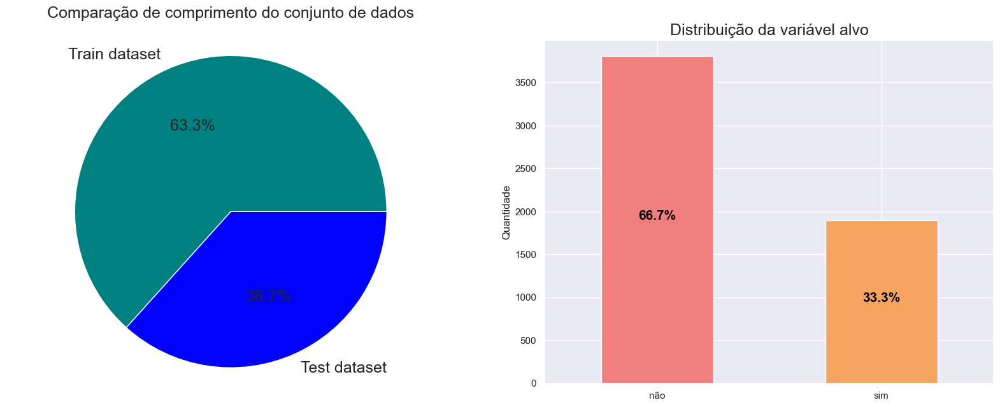

In [63]:
fig, ax = plt.subplots(1,2, figsize=(20, 7))

pie = ax[0].pie([len(df2_train), len(df2_test)],
             labels   = ["Train dataset", "Test dataset"],
             colors   = ["teal", "blue"],
             textprops= {"fontsize": 18},
             autopct  = '%1.1f%%')

ax[0].axis("equal")
ax[0].set_title("Comparação de comprimento do conjunto de dados\n", fontsize=18)
fig.set_facecolor('white')

_ = df2_train.groupby([target])[target].count()  

ax = _.plot(kind    ='bar',
            stacked = True,
            width   = .5,
            rot     = 0,
            color   = colors, 
            grid    = True,
            ax      = ax[1])

ax.set_title('Distribuição da variável alvo'  , fontsize=18)
ax.set_xlabel('', fontsize=12)
ax.set_ylabel('Quantidade', fontsize=12)

total = sum(_)

for i in ax.patches:
    width, height = i.get_width() -.2 , i.get_height()
    x, y  = i.get_xy()      
    alt   = .5
    soma  = 0
    color = 'black'
    ax.annotate(str(round((i.get_height()*100.0/total),1))+'%', 
                (i.get_x()+.55*width, 
                 i.get_y()+soma+alt*height),
                 color   = color,
                 weight = 'bold',
                 size   = 15)            

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
Observamos no gráfico da direita, que os dados estão desbalanceados, sendo assim, precisamos utilizar alguma técnica de balanceamento de dados como: <b>oversampling</b> ou <b>undersampling</b>. 
    
</div>

---

### 2.6.2. Distribuição Train x Test

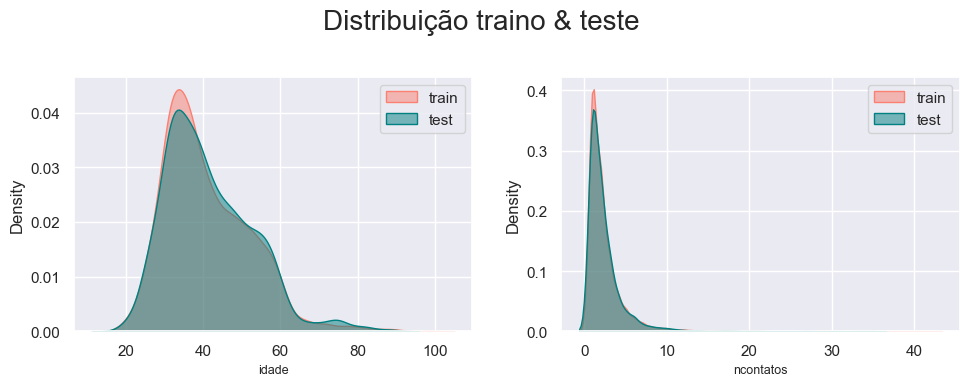

In [64]:
features = df2_test.select_dtypes(np.number).columns

sns.set(style="darkgrid")
plt.figure(figsize=(10,4))

nrow = int(np.ceil(len(features)/2))
ncol = 2

for i, feature in enumerate(features):    
    plt.subplot(nrow, ncol, i+1)    
    ax = sns.kdeplot(df2_train[feature], shade=True, color='salmon',  alpha=0.5, label='train')
    ax = sns.kdeplot(df2_test[feature], shade=True, color='teal',  alpha=0.5, label='test')
    plt.xlabel(feature, fontsize=9)
    plt.legend()    
    
plt.suptitle('Distribuição traino & teste ', fontsize=20)
plt.tight_layout(pad=1.5);

In [ ]:
features = df2_test.select_dtypes(np.number).columns

sns.set(style="darkgrid")
plt.figure(figsize=(10,4))

nrow = int(np.ceil(len(features)/2))
ncol = 2

for i, feature in enumerate(features):    
    plt.subplot(nrow, ncol, i+1)    
    ax = sns.kdeplot(df2_train[feature], shade=True, color='salmon',  alpha=0.5, label='train')
    ax = sns.kdeplot(df2_test[feature], shade=True, color='teal',  alpha=0.5, label='test')
    plt.xlabel(feature, fontsize=9)
    plt.legend()    
    
plt.suptitle('Distribuição traino & teste ', fontsize=20)
plt.tight_layout(pad=1.5);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
Observamos nos gráficos acima que as variáveis seguem a mesma distribuição em ambos os datasets com assimetria positiva, vamos dar uma olhada na distribuição dessas variáveis em relação as variáveis categórica. 
    
</div>

---

<p style="color: black; font-family: Arial Black">Idade:</p>

In [65]:
def distrib_train_test(df_tr_, df_ts_, feature_): 

    _  = df_tr_.dropna() 
    __ = df_ts_.dropna() 

    for col in feature_cat:     
        col_tmp = _[col].unique()     
        row     = int(len(col_tmp)/3)+1     

        plt.figure(figsize=(20,6*row))

        for i, c in enumerate(col_tmp): 
            plt.subplot(row, 3, i+1)
            sns.kdeplot(_[_[col]==c][feature_], shade=True, color='salmon',  alpha=0.5, label='train')
            sns.kdeplot(__[__[col]==c][feature_], shade=True, color='teal',  alpha=0.5, label='test')
            plt.xlabel(c, fontsize=16)
            plt.legend()    

        plt.suptitle('Distribuição traino & teste  da variável {}'.format(col), fontsize=20)
        plt.tight_layout(pad=2);
        plt.show()
        print()

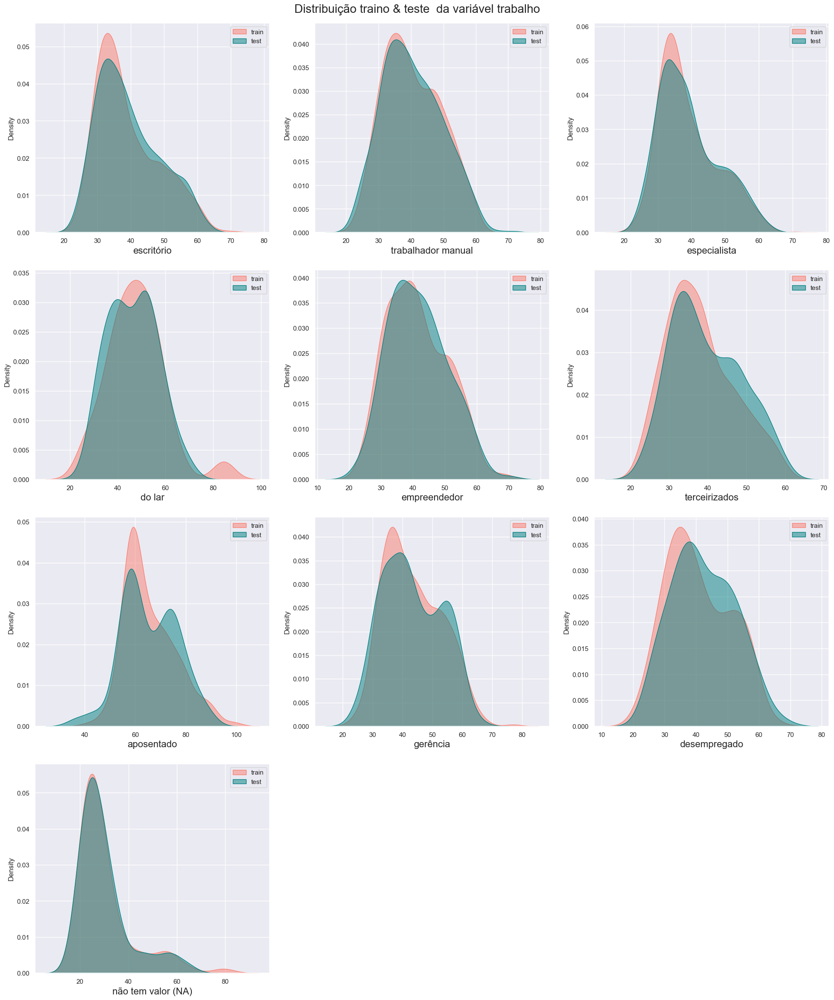

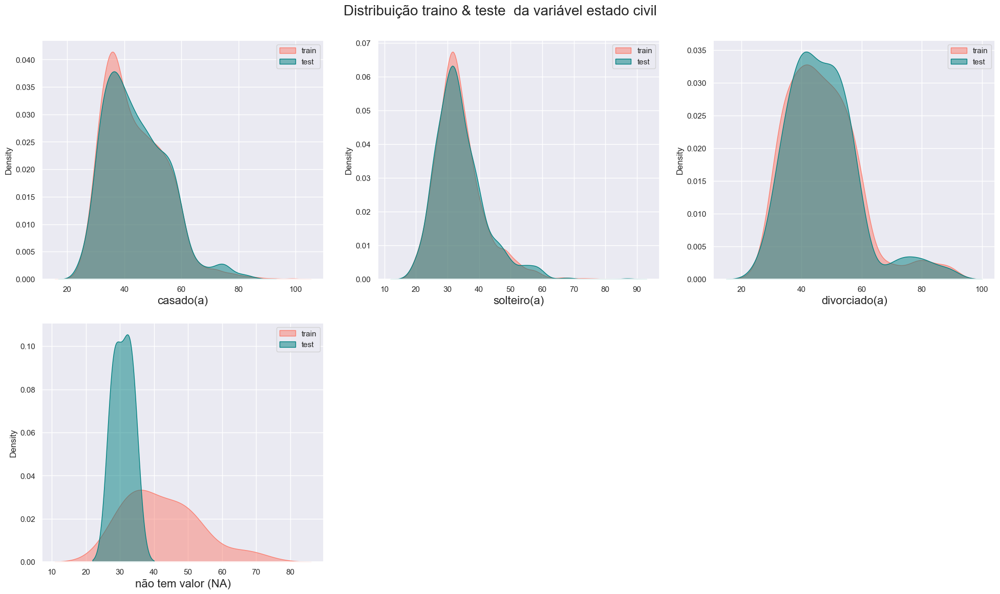

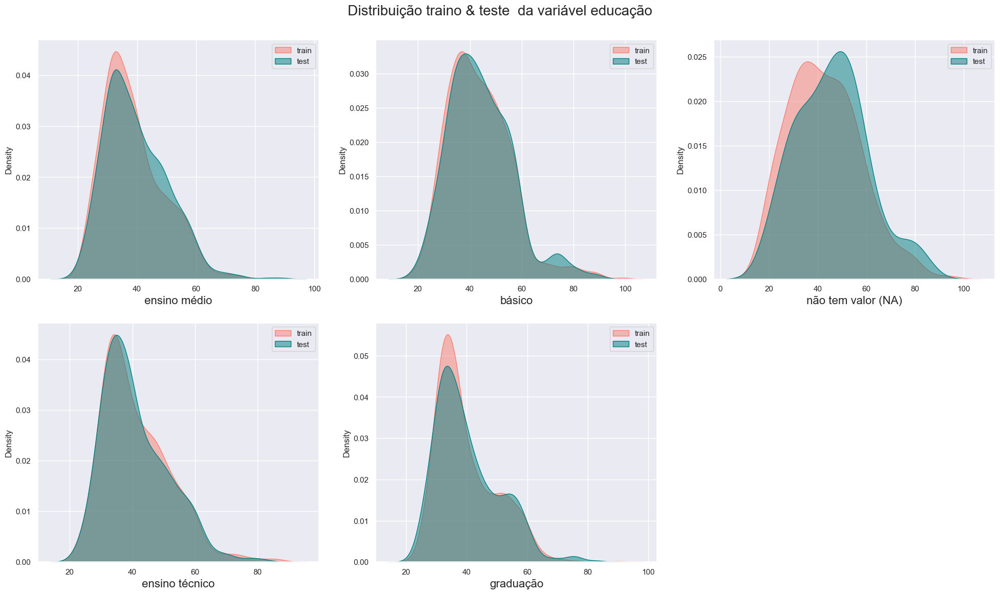

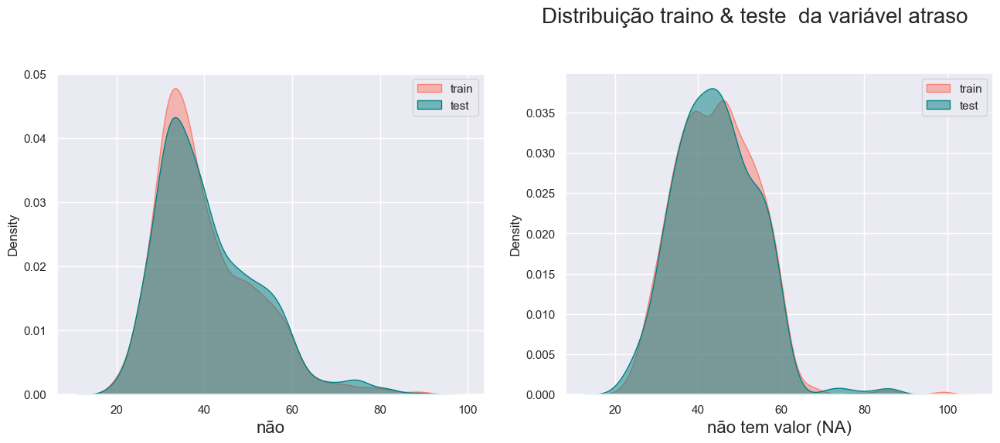

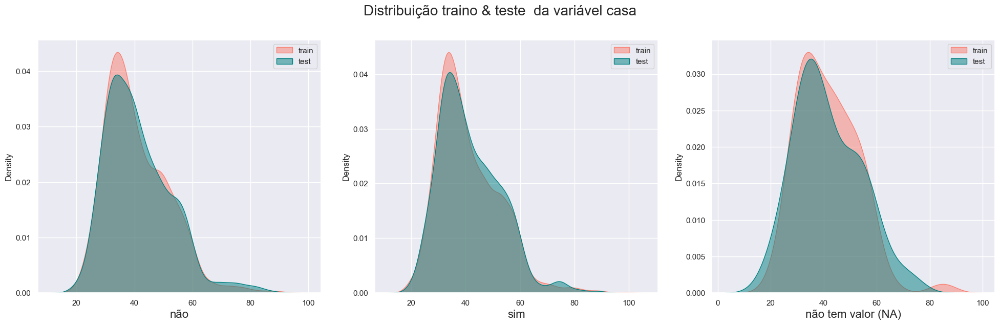

...

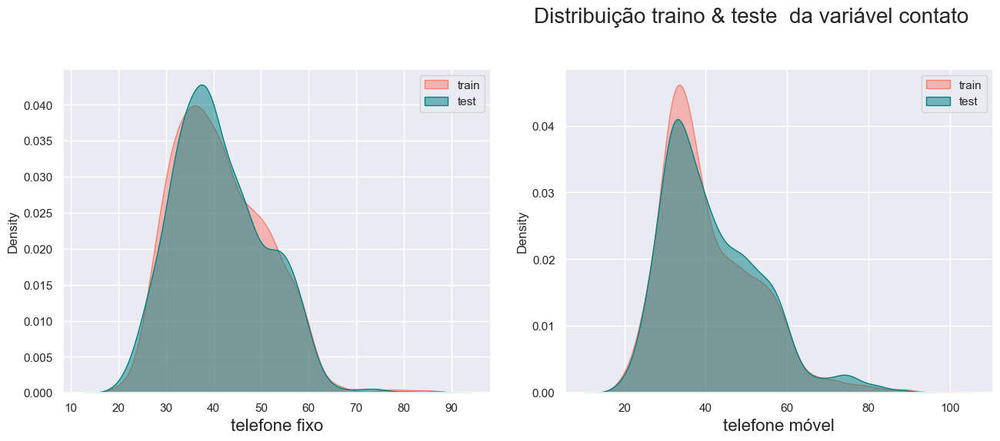

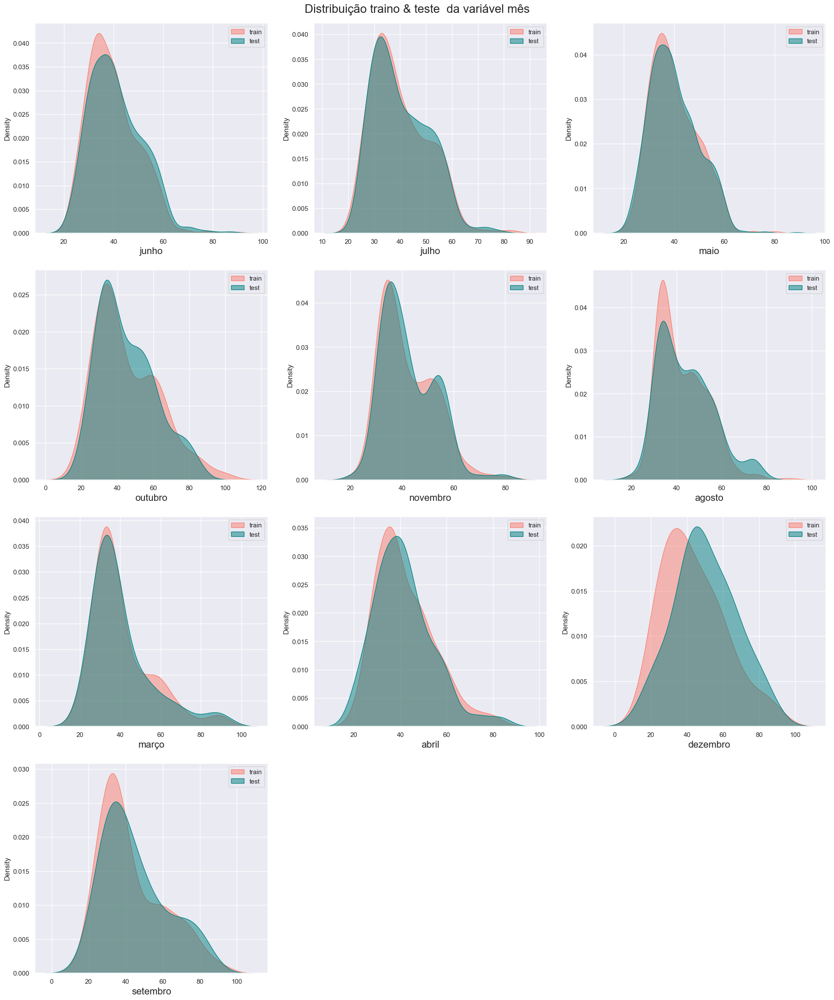

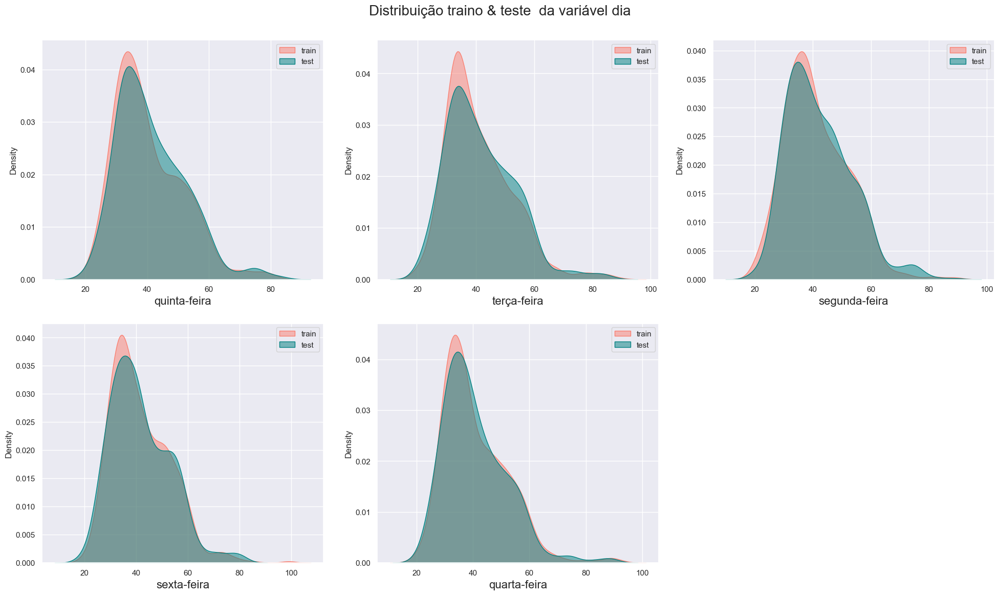

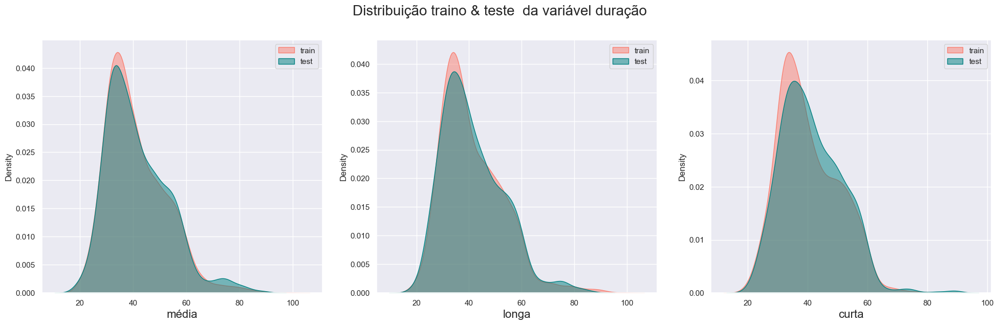

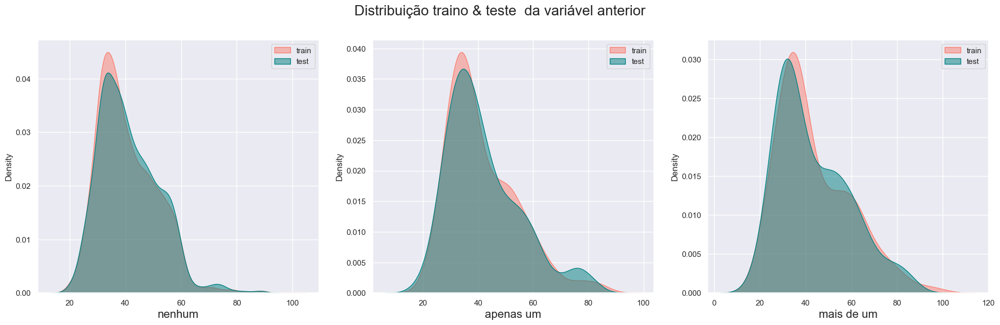

In [393]:
distrib_train_test(df2_train, df2_test, 'idade')

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
- Na variável <b>trabalho</b> na classe do <b>do lar</b> tem uma pequena diferença na parte direita dos dataset entre os valores 60 e 100, outro ponto importante são os valores ausentes entre os dois datasets na variável <b>estado civil</b>, são distribuições diferentes, neste caso precisamos analisar; <p>

- Na variável <b>estado cívil</b> as variáveis que não tem valores a distribuição é totalmente diferente; <p>

</div>

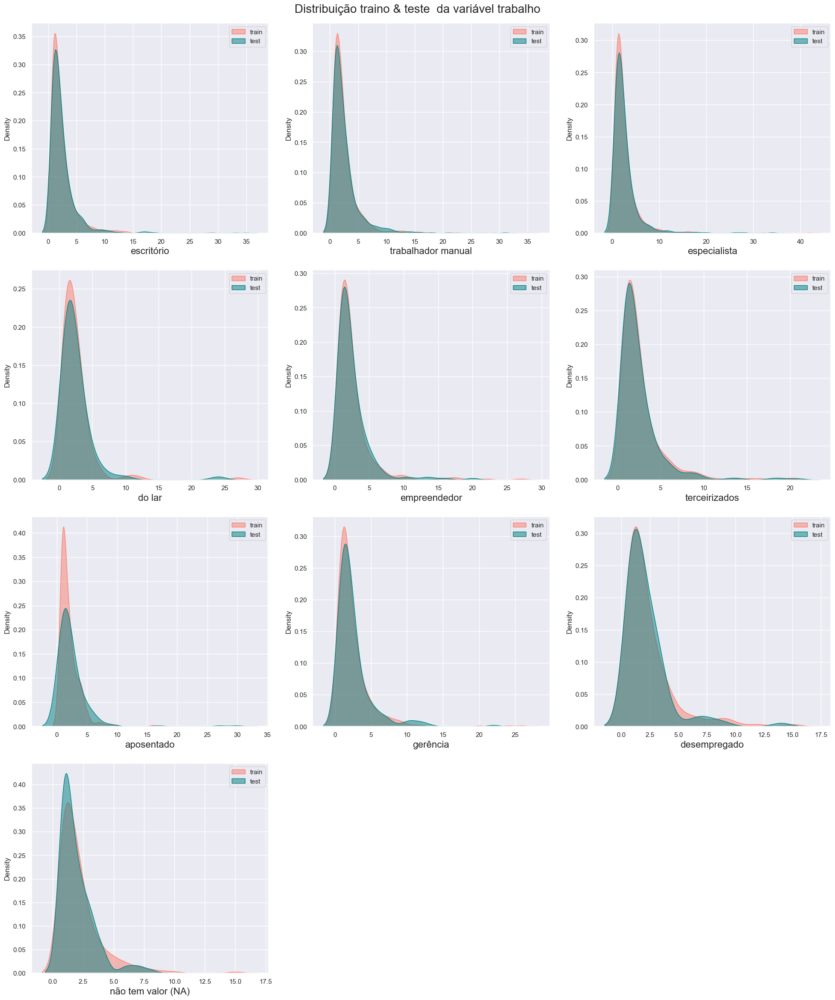

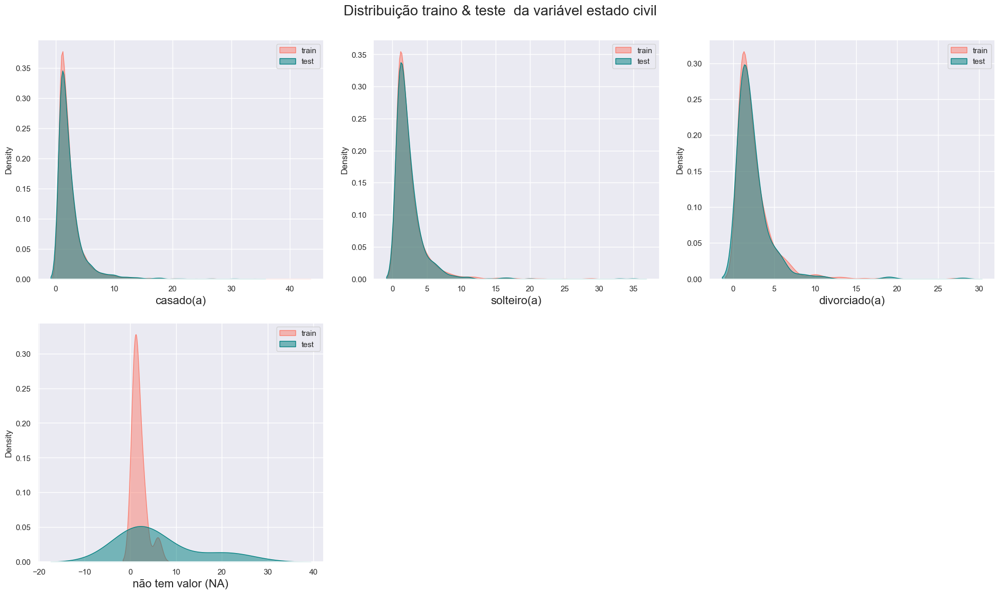

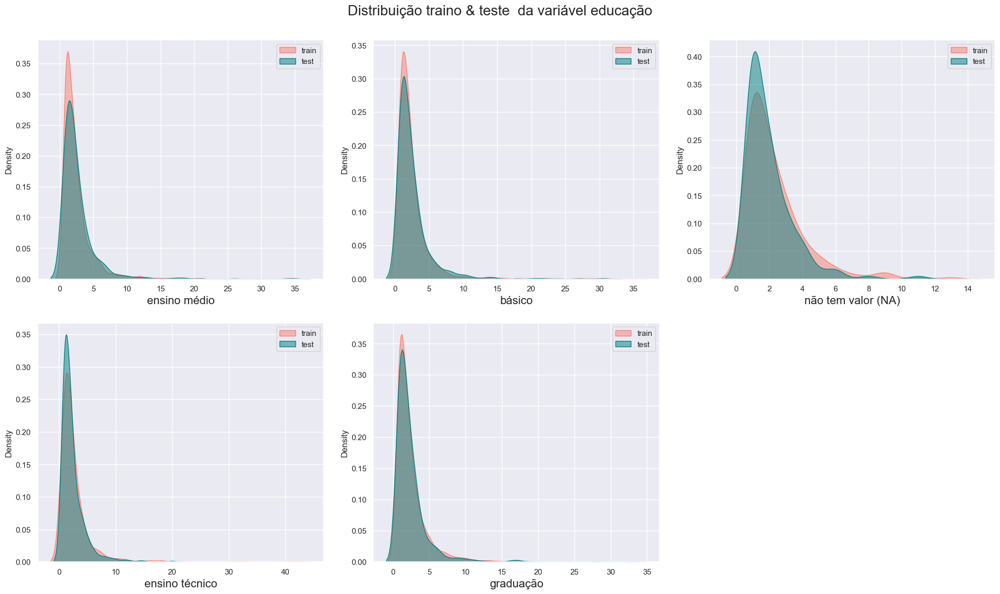

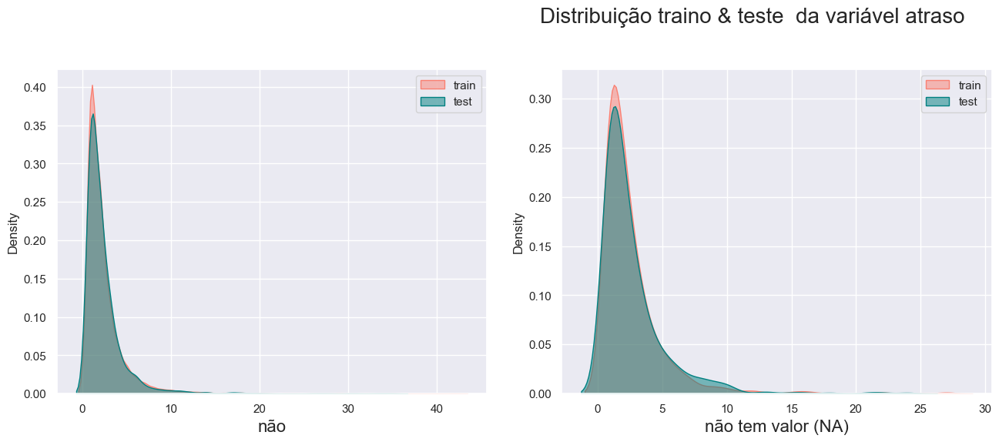

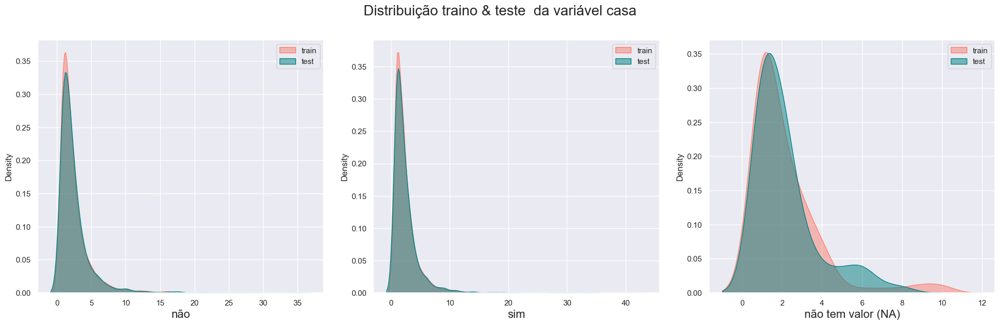

...

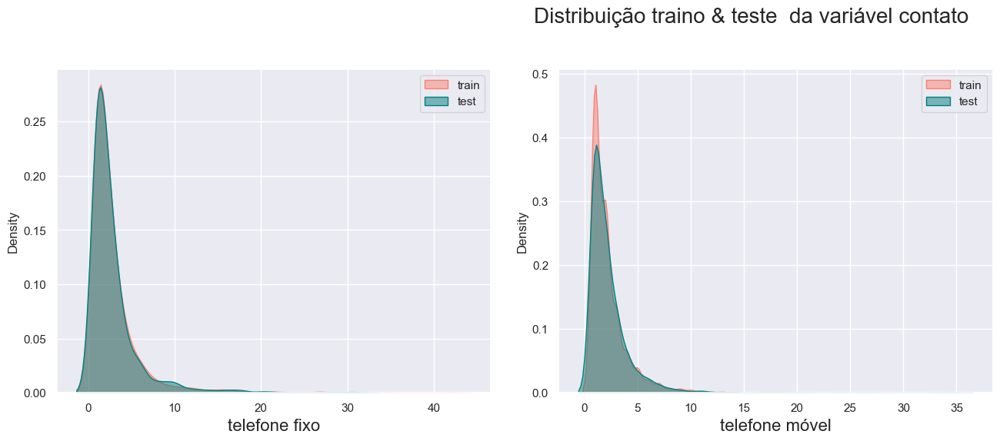

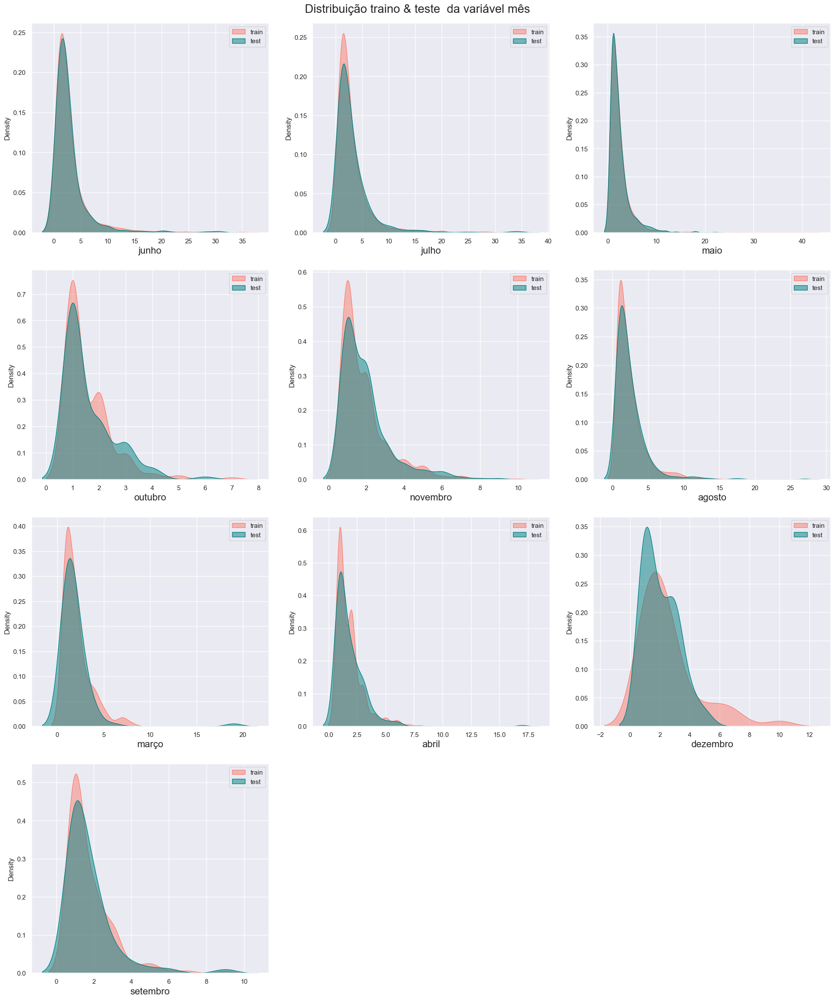

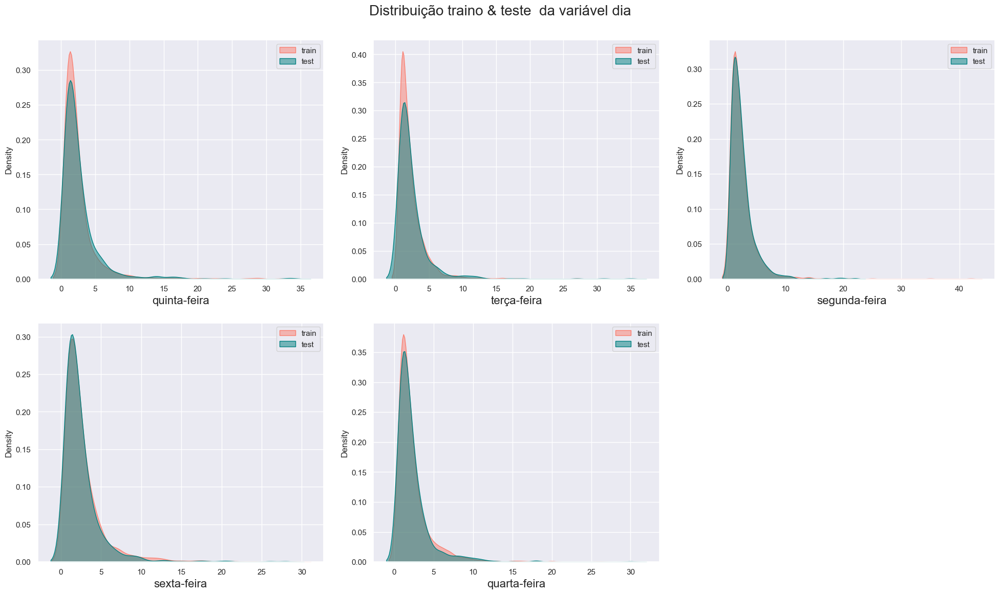

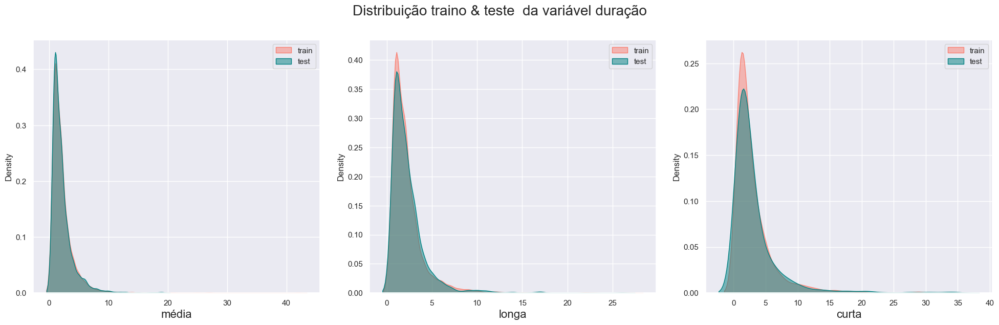

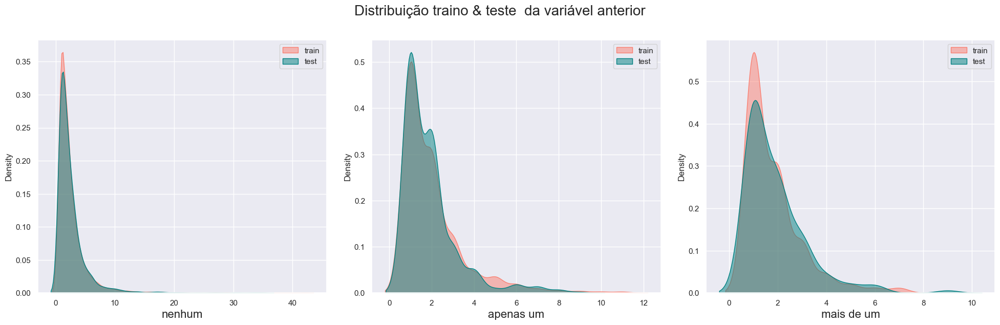

In [67]:
distrib_train_test(df2_train, df2_test, 'ncontatos')

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
- Na variável <b>estado cívil</b> a classe que indica os valores ausentes as distribuições são totalmente diferente; <p>

- Na variável <b>mês</b> na classe <b>dezembro</b> tem uma pequena diferença no dataset de treino entre 6 e 12, isso é, não tem sobreposição do dataset de teste. <p>
    
</div>

---

## 2.6. Outliers

In [68]:
sns.set(style="darkgrid")

In [69]:
def graf_outliers(df_, feature_cat_, feature_): 
    
    plt.figure(figsize=(30,60))
    row = int(len(feature_cat_)/2)+1

    for i, col in enumerate(feature_cat):    
        plt.subplot(row, 2, i+1)        
        sns.boxplot(data=df_, y=feature_, x=col, hue=target)
        plt.title(col, fontsize=20)
        plt.xlabel('')
        plt.ylabel('') 
        plt.xticks(fontsize=14, rotation=20 if i==0 else 0) ;
        plt.yticks(fontsize=14) ;

    plt.suptitle('Boxplot da variável {} x categoricas'.format(feature_), y=.90, fontsize=30);
    fig.tight_layout(pad=1.0);

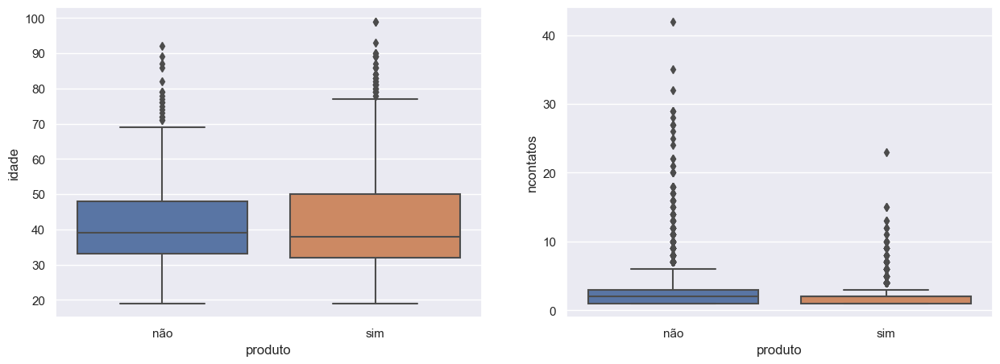

In [70]:
plt.figure(figsize=(15, 5))
f_flot = feature_float.copy() 
f_flot.append(target)
 
plt.subplot(1, 2, 1)
sns.boxplot(data=df2_train, y='idade', x=target);

plt.subplot(1, 2, 2)
sns.boxplot( data=df2_train, y='ncontatos', x=target);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
Temos os seguintes ponto: 
- Ambas variáveis tem outliers; 
- Visualmente a variável idade em ambas classe tem a mesma mediana.  <p>
    
Vamos fazer os boxplots em relação as variáveis categórica: <p>    

</div>

<p style="color: black; font-family: Arial Black"> - IDADE</p>

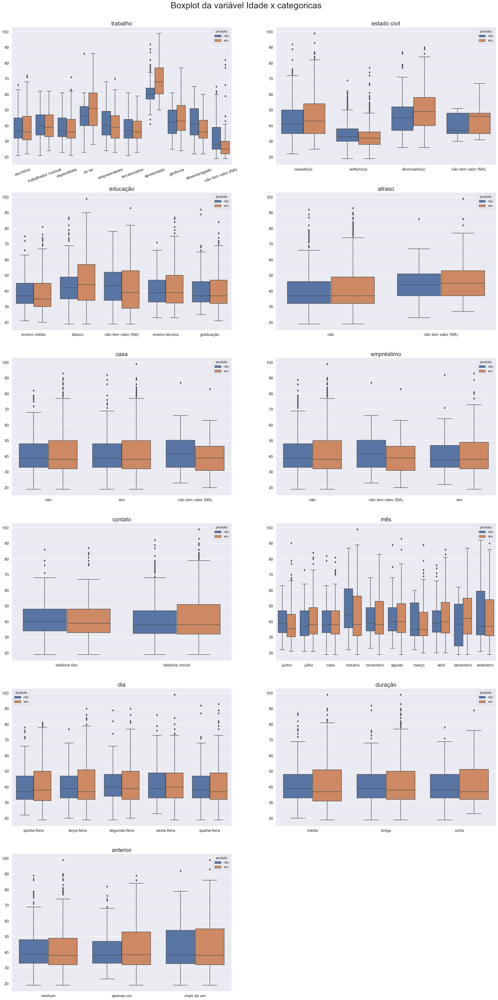

In [71]:
sns.set(style="darkgrid")
plt.figure(figsize=(30,60))
row = int(len(feature_cat)/2)+1

for i, col in enumerate(feature_cat):    
    plt.subplot(row, 2, i+1)        
    sns.boxplot(data=df2_train, y='idade', x=col, hue=target)
    plt.title(col, fontsize=20)
    plt.xlabel('')
    plt.ylabel('') 
    plt.xticks(fontsize=14, rotation=20 if i==0 else 0) ;
    plt.yticks(fontsize=14) ;
    
plt.suptitle('Boxplot da variável Idade x categoricas', y=.90, fontsize=30);
fig.tight_layout(pad=1.0);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
  
Todas as variáveis tem outliers, na variável <b>trabalho</b> que é aposentado acima de 60 anos tem maior chance de compra um produto. Em relação das outras variáveis categóricas não temos pontos relevante. Uma binarização da variável <b>idade</b> levando em consideração a distribuição em relação a variável <b>trabalho</b> pode ajudar na modelagem com a idenficação de padrões. <p>

</div>

---

<p style="color: black; font-family: Arial Black"> - NCONTATOS</p>

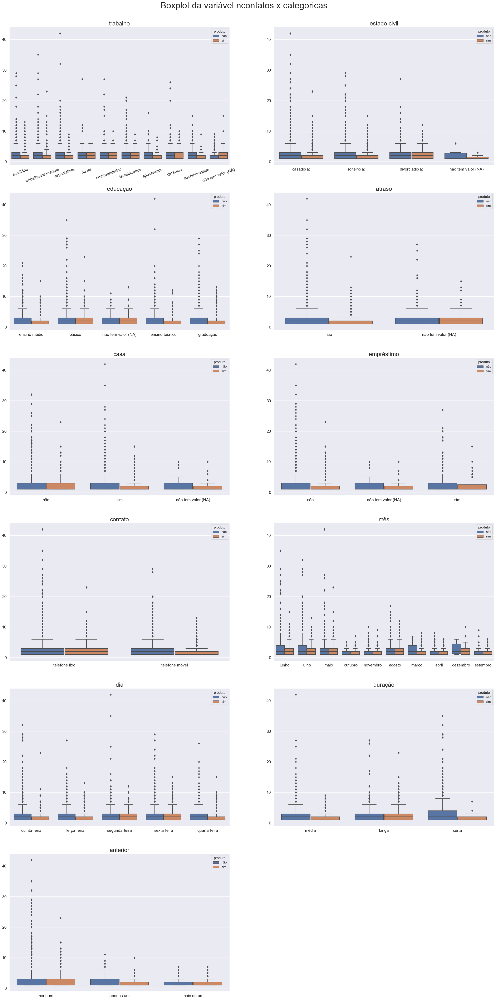

In [72]:
sns.set(style="darkgrid")
plt.figure(figsize=(30,60))
row = int(len(feature_cat)/2)+1

for i, col in enumerate(feature_cat):    
    plt.subplot(row, 2, i+1)        
    sns.boxplot(data=df2_train, y='ncontatos', x=col, hue=target)
    plt.title(col, fontsize=20)
    plt.xlabel('')
    plt.ylabel('') 
    plt.xticks(fontsize=14, rotation=20 if i==0 else 0) ;
    plt.yticks(fontsize=14) ;
    
plt.suptitle('Boxplot da variável ncontatos x categoricas', y=.90, fontsize=30);
fig.tight_layout(pad=1.0);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
  

</div>

In [400]:
_tr, _ts = utility.outlier_create_feature_check(df_tr_ = df2_train, 
                                         df_ts_ = df2_test, 
                                         cols_=['ncontatos'], #'idade', 
                                         qt_inferior_  = .25, 
                                         qt_superior_  = .75, 
                                         flg_ts_       = True, 
                                         input_limete_ = False, 
                                         verbose_      = True)

Com a variável ncontatos
 0    5411
-1     289
Name: fe_outlier, dtype: int64



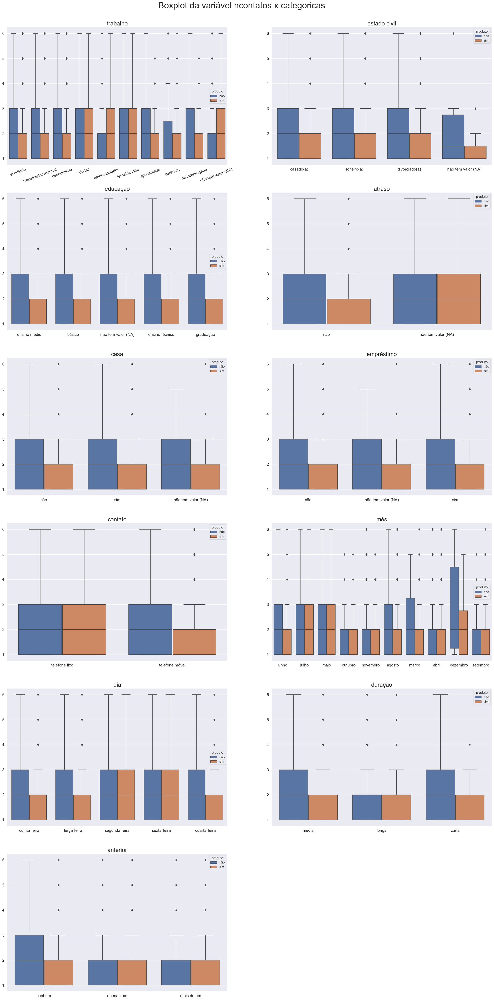

In [401]:
_ = _tr[_tr['fe_outlier']==0]


sns.set(style="darkgrid")
plt.figure(figsize=(30,60))
row = int(len(feature_cat)/2)+1

for i, col in enumerate(feature_cat):    
    plt.subplot(row, 2, i+1)        
    sns.boxplot(data=_, y='ncontatos', x=col, hue=target)
    plt.title(col, fontsize=20)
    plt.xlabel('')
    plt.ylabel('') 
    plt.xticks(fontsize=14, rotation=20 if i==0 else 0) ;
    plt.yticks(fontsize=14) ;
    
plt.suptitle('Boxplot da variável ncontatos x categoricas', y=.90, fontsize=30);
fig.tight_layout(pad=1.0);


---

## 2.7. Correlação

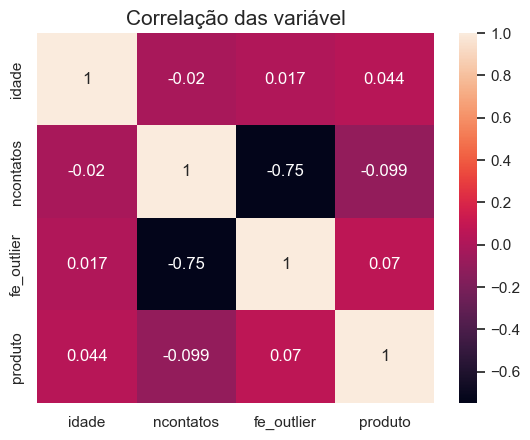

In [402]:
_ = _tr.copy()
_[target] = _[target].map({'sim':1,'não':0})

sns.heatmap(_[['idade', 'ncontatos', 'fe_outlier',  target]].corr(), 
            annot = True, 
            mask  = False).set_title('Correlação das variável', fontsize=15);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
 
Ambas as variáveis tem baixa correlação com alvo, podemos fazer uma discretização dessas variáveis antes de remové-las da modelagem. Vamos fazer esse teste no processamento. 
    
    
</div>

## 2.7. Dados Qualitativos

### 2.7.1. Proporção de variáveis

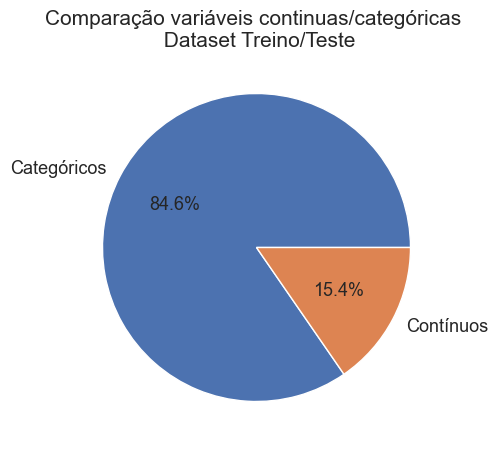

In [403]:
fig, ax = plt.subplots(figsize=(5, 5))

plt.pie([ len(feature_cat), len(feature_float)], 
        labels=['Categóricos', 'Contínuos' ],
        textprops={'fontsize': 13},
        autopct='%1.1f%%')

#ax.axis("equal")
ax.set_title("Comparação variáveis continuas/categóricas \n Dataset Treino/Teste", fontsize=15)
fig.set_facecolor('white')
plt.show()

Vamos fazer uma contagem das observações e em cada variável categórica, para termos uma noção de como nosso conjunto de dados estar distribuído.

In [404]:
for i in feature_cat:
    print("Coluna: ",i)
    print('-'*30)
    print('TREINO:',  df2_train[[i]].value_counts(), '\n') 
    print('TESTE :',  df2_test[[i]].value_counts(), "\n")

Coluna:  trabalho
------------------------------
TREINO: trabalho          
escritório            1530
trabalhador manual    1174
especialista           905
terceirizados          509
gerência               421
empreendedor           356
aposentado             281
não tem valor (NA)     223
desempregado           156
do lar                 145
dtype: int64 

TESTE : trabalho          
escritório            880
trabalhador manual    677
especialista          533
terceirizados         295
gerência              227
empreendedor          201
aposentado            195
não tem valor (NA)    117
desempregado           91
do lar                 84
dtype: int64 

Coluna:  estado civil
------------------------------
TREINO: estado civil      
casado(a)             3315
solteiro(a)           1760
divorciado(a)          612
não tem valor (NA)      13
dtype: int64 

TESTE : estado civil      
casado(a)             1983
solteiro(a)            966
divorciado(a)          346
não tem valor (NA)       5

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
- A variável <b>atraso</b> tem apenas uma categorial em ambos dataset, podemos fazer a exclusão dessa variável. 
    
Vamos dar uma olhada na correlação das variaveis categóricas, criamos uma função que calcula a matriz de coeficientes de Cramer, que permite entender a correlação entre duas variáveis categóricas em um conjunto de dados.<p>
    
</div>

### 2.7.2. Correlação
Primeira coisa que vamos fazer é criar um novo dataset e transformar a variável <b>hora</b> em categórica, assim vamos ter uma ideia da magnetute da variável como categórica. 

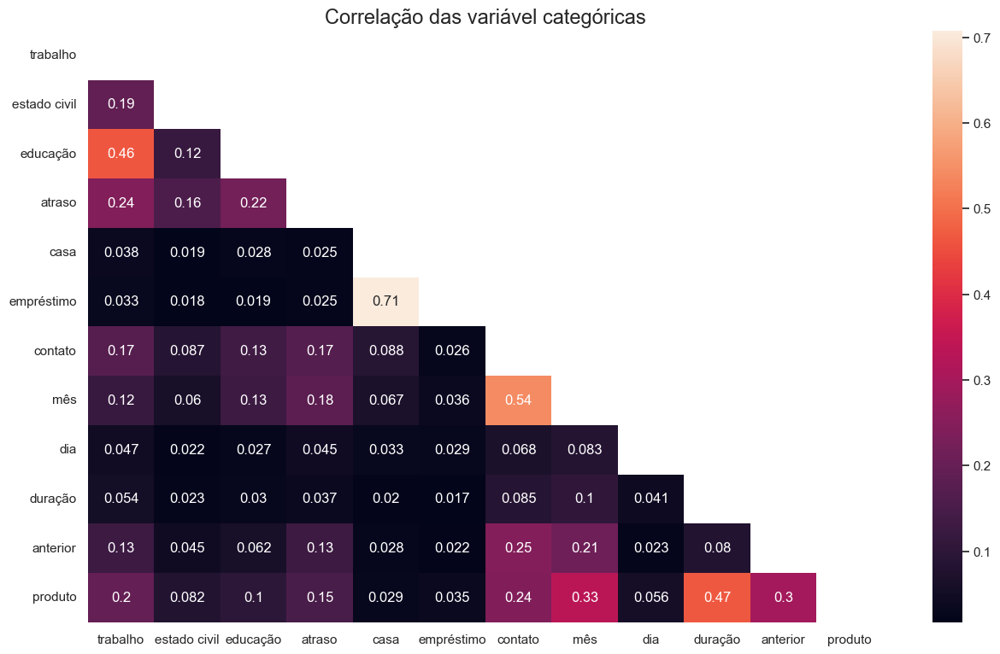

In [405]:
df_cat         = df2_train.copy()
f_cat          = feature_cat.copy()

sns.set_theme(style="whitegrid", palette="pastel")

plt.figure(figsize=(15,9))

df         = df_cat[f_cat]
df[target] = df_cat[target].astype(object)

corr = utility.generate_category_table(df)
mask = np.triu(np.ones_like(corr, dtype=bool))

sns.heatmap(corr, annot=True, mask= mask).set_title('Correlação das variável categóricas', fontsize=17);

del df

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
        
Temos uma correlação baixa entre as variáveis e também vel 
A correlação é entre as variávei é baixa, em relação a variável alvo a correlação é muito baixa, a variável <b>duração</b> tem a maior correlção com a variável alvo, é um indicativo que essa variável será significativa para a modelagem, seguida da variável <b>mês</b>. <p> <br>
        
Vamos fazer uma análise de cada variável. <p>
    

</div>

### 2.7.3. Análise univarianda

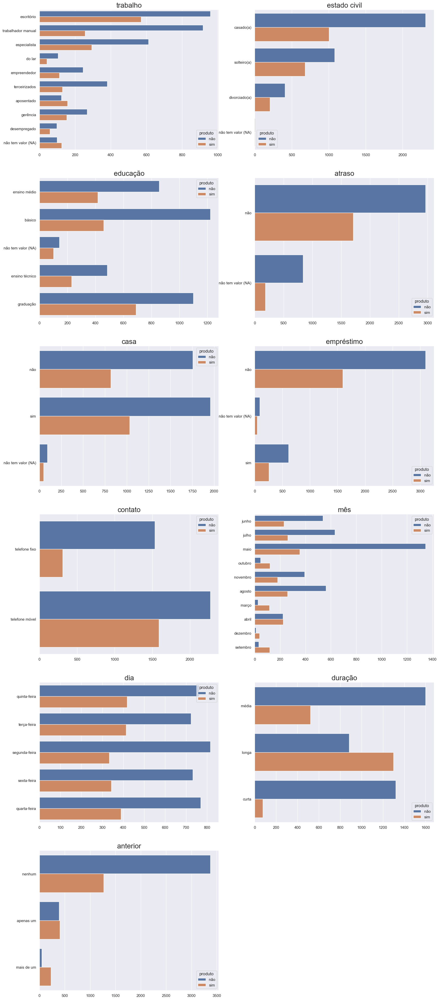

In [406]:
sns.set(style="darkgrid")
plt.figure(figsize=(20,50))

row = int(len(feature_cat)/2)+1

for i, col in enumerate(feature_cat):    
    plt.subplot(row, 2, i+1)
    sns.countplot(data=df2_train, y=col, hue=target, orient='v')
    plt.title(col, fontsize=20)
    plt.xlabel('')
    plt.ylabel('')
fig.tight_layout(pad=3.0);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
  

Vamos fazer uma análise mais detalhada, com o cruzamento dessas variáveis.

</div>

### 2.7.4. Análise bivariada

Error in callback <function _draw_all_if_interactive at 0x0000029AA2BFAF70> (for post_execute):


KeyboardInterrupt: 

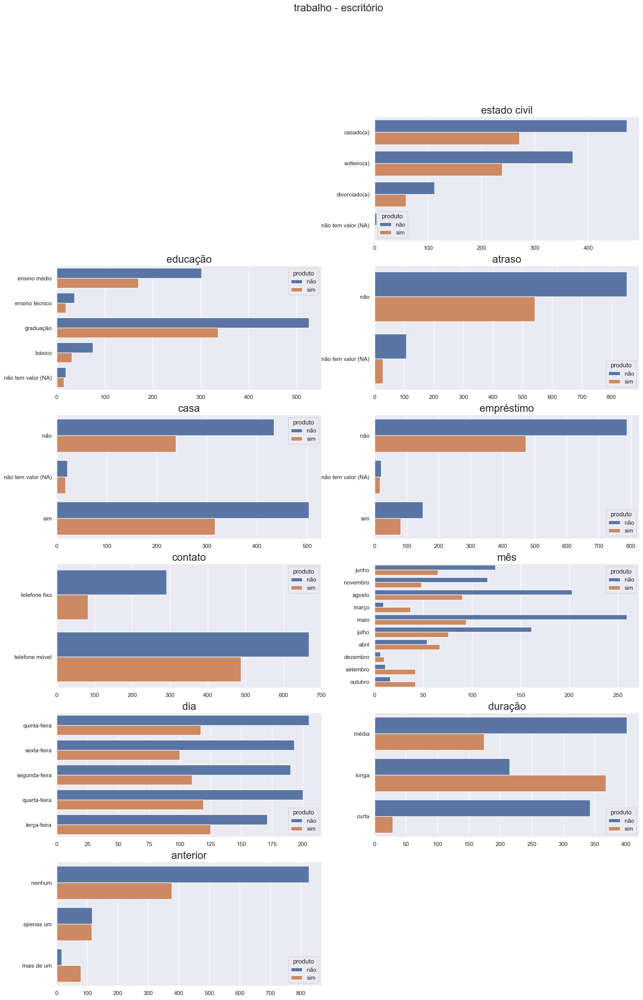

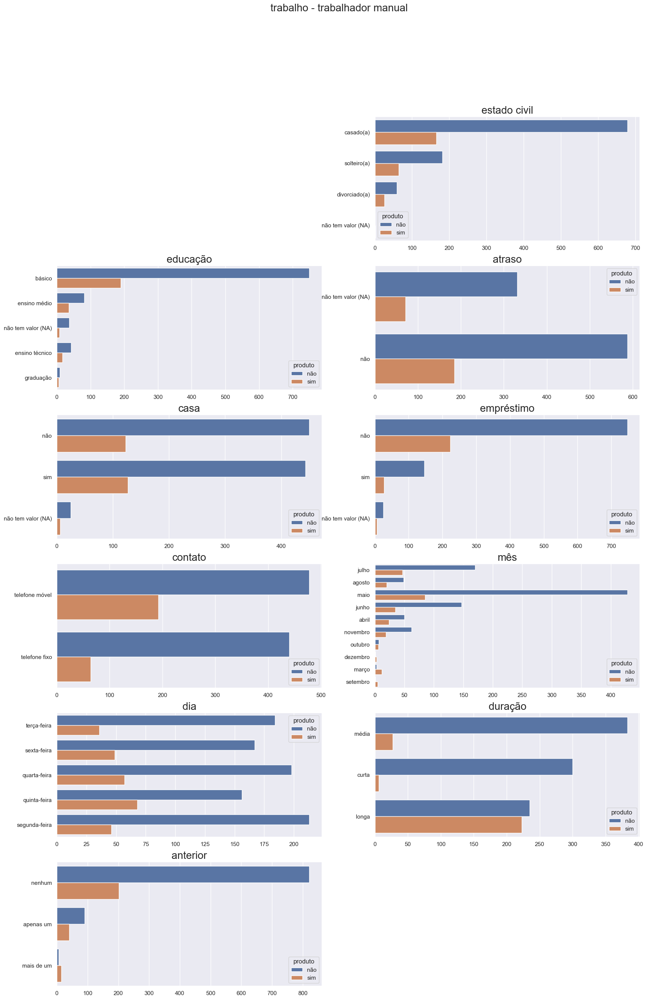

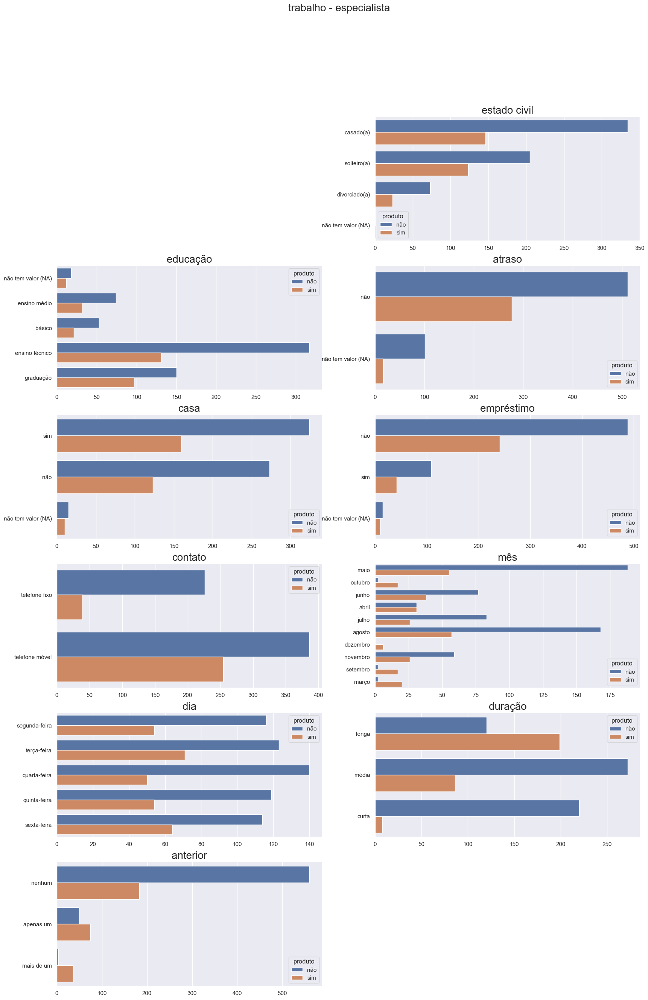

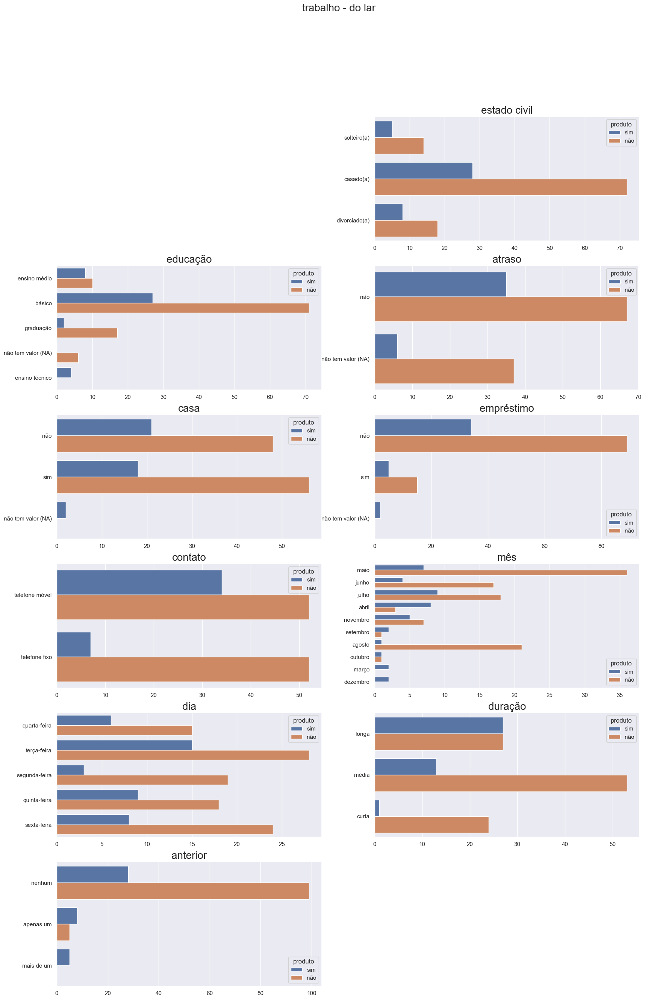

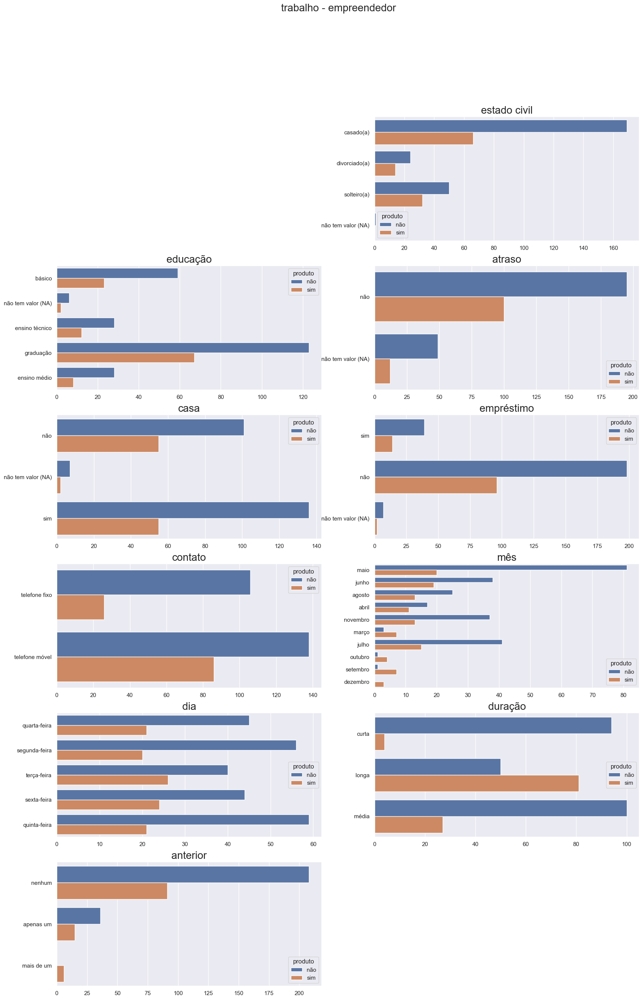

...

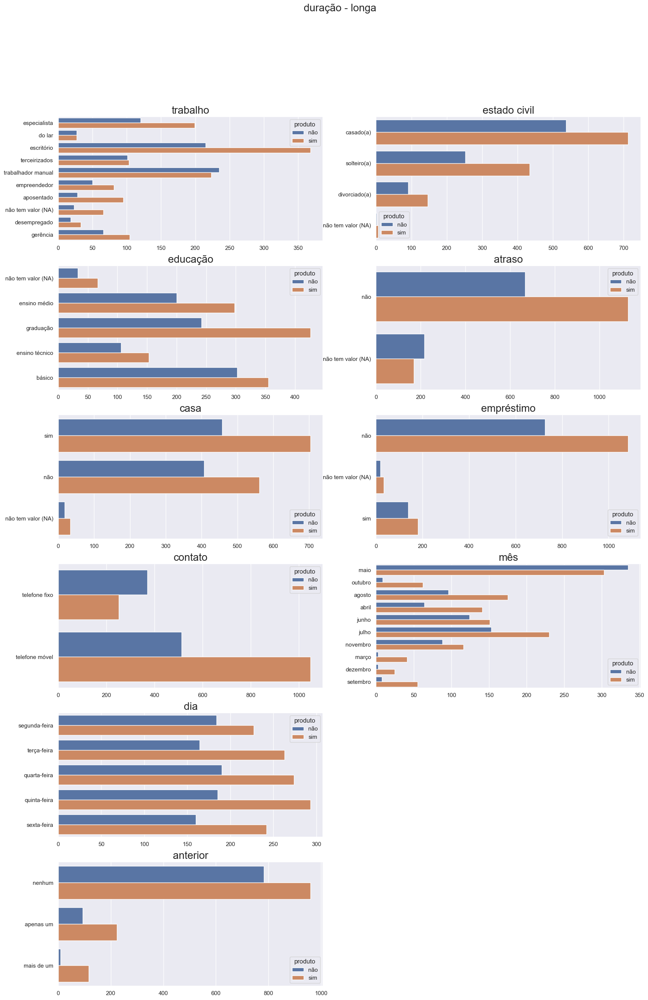

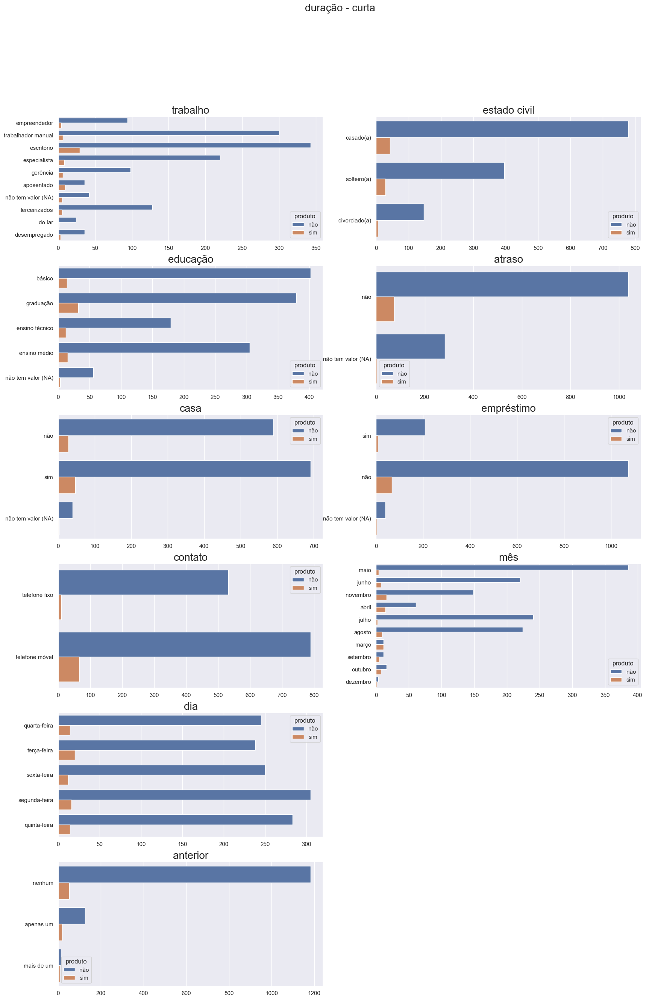

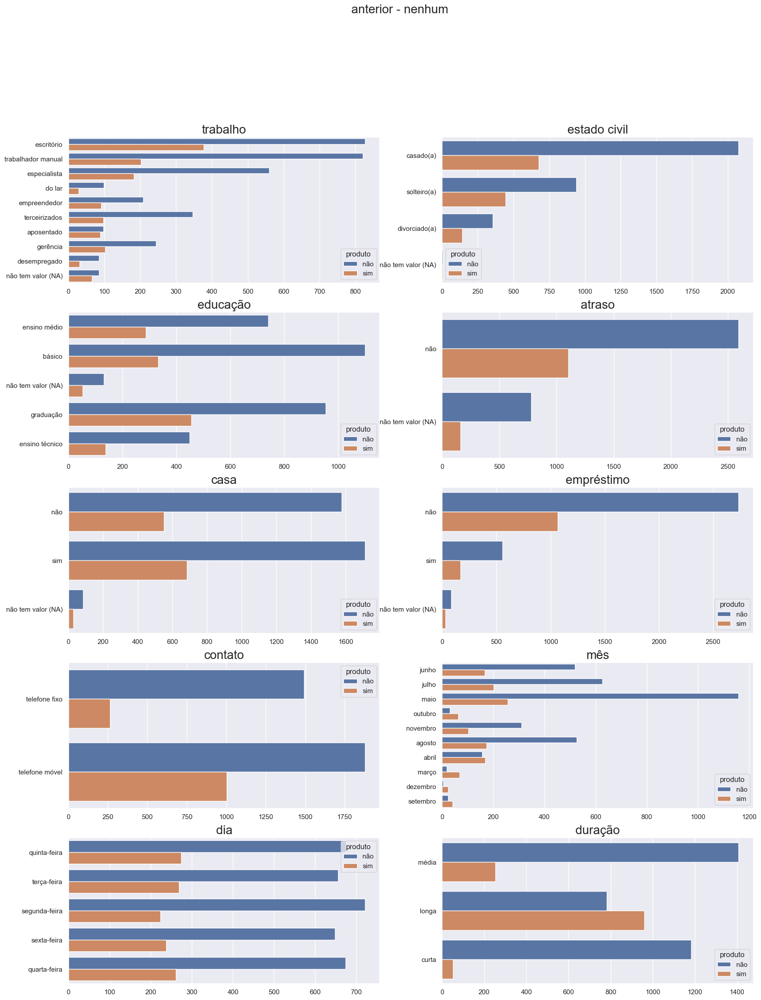

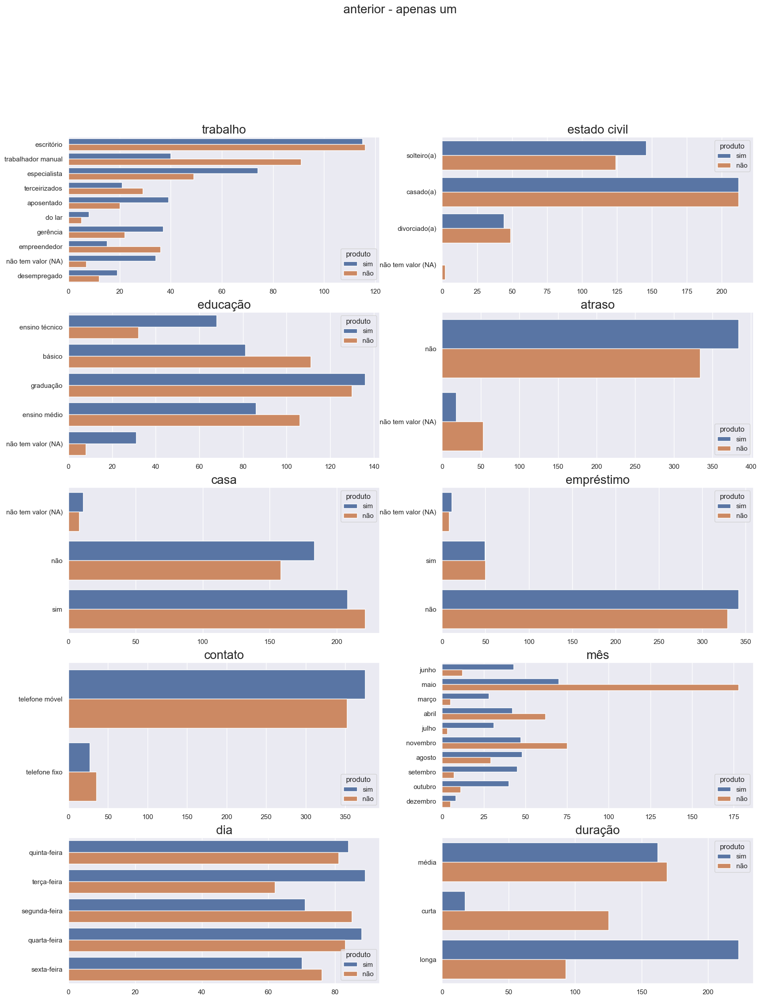

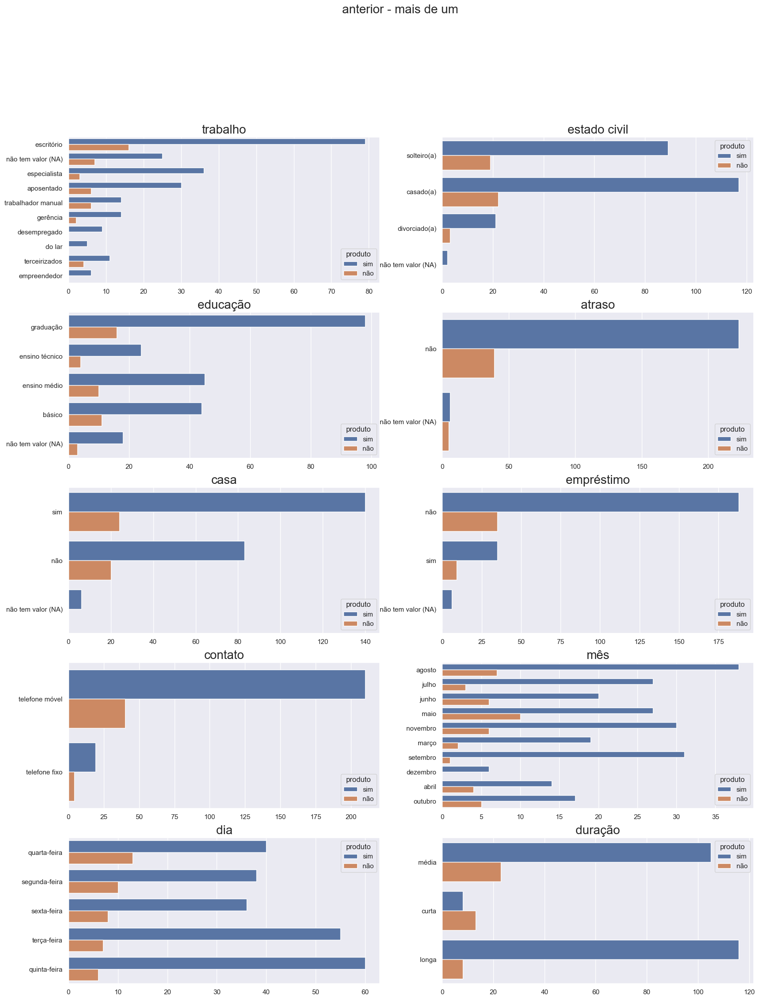

In [407]:
for i, col1 in enumerate(feature_cat):
    feature_classe_unique = list(df2_train[col1].unique())   
    #feature_classe_unique = ['escritório']
    rows = int(len(feature_cat)/2)+1
    for col_classe in feature_classe_unique:         
        plt.figure(figsize=(20,30))
        for i, col2 in enumerate(feature_cat):                       
            if col1!=col2:
                _ = df2_train[(df2_train[col1] == col_classe)]
                plt.subplot(rows, 2, i+1)
                sns.countplot(data=_, y=col2, hue=target, )
                plt.xlabel('')
                plt.ylabel('')
                plt.title('{}'.format(col2), fontsize=20);
                plt.suptitle('{} - {}'.format(col1, col_classe), fontsize=20)
               
        fig.tight_layout(pad=1.0);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
 
- No sabado quando temos feriado aumenta a quantidade de aluguél, porém não parece ser muito significativo o feriado neste dia, porém domingo, segunda e quinta temos uma baixa significativa quando é feriado, a criação de uma variável indicando final de semana e quinta pode ser signifincativa para ajudar a identificar padrões; <p>

- No inverno temos um baixa nos aluguéis, no verão temos um aumento no número de aluguéis, seguido da primavera, aqui demos um ponto importante que devemos destacar, modelagem para estação do ano pode ser um diferencial, pois podemos identificar diferenças significante visualmente.
    
Vamos dar uma olhada na variável <b>hora</b> em relação as variaveis categoricas.     
</div>

## 2.8. Dados Quantitativos

### 2.8.1. Correlação
Vamos examinar a correlação entre as variáveis.

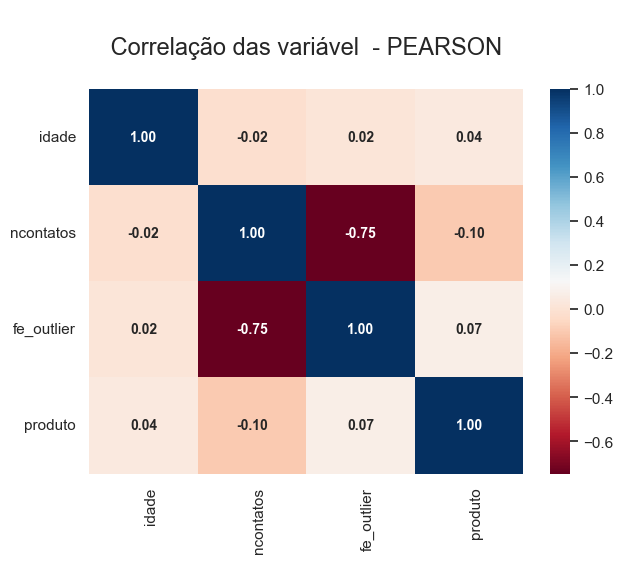

Variáveis autocorrelacionadas threshold=0.70


,var_1,var_2,corr
0,ncontatos,fe_outlier,-0.74717
1,fe_outlier,ncontatos,-0.74717


In [414]:
sns.set(style="whitegrid", palette="pastel")
plt.figure(figsize=(7,5))
__ = df2_train[target] 
_ = df2_train.drop(target, axis=1) .copy() 
_[target] = __.map({'sim':1, 'não':0})
utility.graf_feature_corr(df_         = _, 
                        annot_      = True, 
                        threshold_  = .7, 
                        print_var_  = True, 
                        print_graf_ = True, 
                        mask_       = False);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
  


    
</div>

<div style="color:white;border-radius:8px;background-color:#a7d5ed">    
    <h1 style="padding:12px;color:black;"> 3. Modelagem </h1>    
</div>

Neste primeiro momento vamos fazer um processameto simples e não vamos nos preocupar com as variáveis autocorrelacionadas, será utilizado o <b>XGB</b> como linha de base e vamos utilizar para balanceamento dos dados o parametro <b>"scale_pos_weight"</b>, mais tarde vamos fazer testes com outras técnicas de balanceamento de dados. 

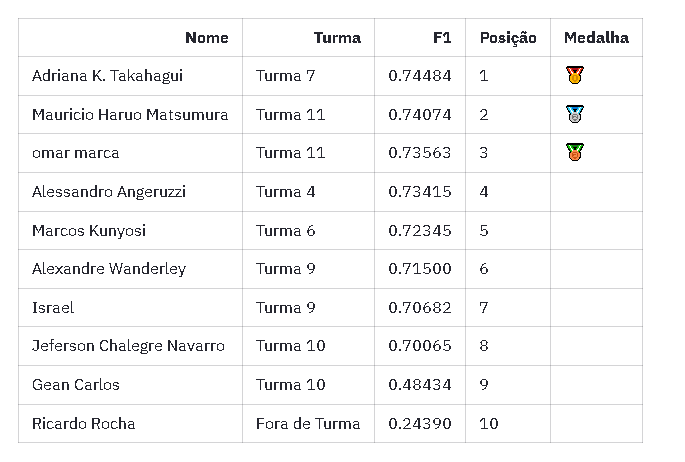

## 3.1. Split Train/Test

In [1000]:
df3_train = df2_train.copy()
df3_test  = df2_test.copy()

seed   = 12359
X      = df3_train.drop(target, axis=1)
y      = df3_train[target].map({'sim':1, 'não':0})
X_test = df3_test

X_train, X_valid, y_train, y_valid = train_test_split(X, y, 
                                                      test_size    = 0.5,
                                                      shuffle      = True, 
                                                      random_state = seed)

X_train.shape, y_train.shape, X_valid.shape, y_valid.shape , X_test.shape

((2850, 14), (2850,), (2850, 14), (2850,), (3300, 14))

## 3.2. Processamento 

Neste primeiro momento para linha de base vamos fazer uma binalização das variáveis qualitativas. 

In [1001]:
def bin_idade(df_): 
    
    df_['idade_group'] = 'Maio_ou_60' 
    df_['idade_group'][df_['idade']<=24] = 'Menor_24'
    df_['idade_group'][(df_['idade']>24) & (df_['idade']<=35)] = 'Entre_24_35'
    df_['idade_group'][(df_['idade']>35) & (df_['idade']<=45)] = 'Acima_35_e_Menor_Igual_45'
    df_['idade_group'][(df_['idade']>45) & (df_['idade']<=55)] = 'Acima_45_e_Menor_Igual_55'
    df_['idade_group'][(df_['idade']>55) & (df_['idade'] <60)] = 'Acima_55_e_Menor_Igual_60'
    
    df_.drop('idade', axis=1, inplace=True)
    return df_

In [1002]:
def feature_binarizer(df_tr_, df_vl_, df_ts_, features_ohe_=None, feature_ord_=None):

    if features_ohe_ is not None:
        for col in features_ohe_:                 
            lb   = OneHotEncoder(sparse=False) # LabelBinarizer() OneHotEncoder
            cols = df_tr_[col].unique().tolist()
            
            cols_fe = []
            for x in df_tr_[col].unique().tolist(): 
                cols_fe.append('fe_'+ col + '_' +str(x) )
            
            df_lb_tr = pd.DataFrame(lb.fit_transform (df_tr_[[col]]), columns=cols_fe)
            df_lb_vl = pd.DataFrame(lb.transform (df_vl_[[col]]), columns=cols_fe)
            df_lb_ts = pd.DataFrame(lb.transform (df_ts_[[col]]), columns=cols_fe)
            
            df_lb_tr[cols_fe]= df_lb_tr[cols_fe].astype(int)
            df_lb_vl[cols_fe]= df_lb_vl[cols_fe].astype(int)
            df_lb_ts[cols_fe]= df_lb_ts[cols_fe].astype(int)

            df_lb_tr.index =  df_tr_.index
            df_lb_vl.index =  df_vl_.index
            df_lb_ts.index =  df_ts_.index

            df_tr_ = pd.concat([df_tr_, df_lb_tr], axis=1)
            df_vl_ = pd.concat([df_vl_, df_lb_vl], axis=1)
            df_ts_ = pd.concat([df_ts_, df_lb_ts], axis=1)

            df_tr_.drop(col, axis=1, inplace=True)
            df_vl_.drop(col, axis=1, inplace=True)
            df_ts_.drop(col, axis=1, inplace=True)

            
    col     = ''
    cols_fe = ''

    if feature_ord_ is not None:
        for col in feature_ord_:
            ordEncoder = OrdinalEncoder()            
            cols = df_tr_[col].unique().tolist() 

            cols_fe = []
            for x in df_tr_[col].unique().tolist(): 
                cols_fe.append('fe_'+ col + '_' +str(x) )
                
            df_tr_[col] = ordEncoder.fit_transform(df_tr_[[col]])
            df_vl_[col] = ordEncoder.transform (df_vl_[[col]])
            df_ts_[col] = ordEncoder.transform (df_ts_[[col]])

            df_tr_[col] = df_tr_[col].astype(int)
            df_vl_[col] = df_vl_[col].astype(int)
            df_ts_[col] = df_ts_[col].astype(int)

    df_tr_ = utility.reduce_memory_usage(df_tr_, verbose=False)
    df_vl_ = utility.reduce_memory_usage(df_vl_, verbose=False)
    df_ts_ = utility.reduce_memory_usage(df_ts_, verbose=False)

    return df_tr_, df_vl_, df_ts_

In [1003]:
X_train = bin_idade(X_train)
X_valid = bin_idade(X_valid)
X_test  = bin_idade(X_test)

cols_oho = ['trabalho', 'estado civil','atraso', 'casa', 'empréstimo', 'contato', 'anterior'] 
cols_ord = ['educação', 'mês', 'dia', 'duração', 'idade_group']
    
X_train, X_valid, X_test = feature_binarizer(X_train, X_valid, X_test, cols_oho, cols_ord)

In [1004]:
X_train.head()

,educação,mês,dia,duração,ncontatos,fe_outlier,idade_group,fe_trabalho_desempregado,fe_trabalho_não tem valor (NA),fe_trabalho_especialista,fe_trabalho_escritório,fe_trabalho_trabalhador manual,fe_trabalho_empreendedor,fe_trabalho_gerência,fe_trabalho_terceirizados,fe_trabalho_aposentado,fe_trabalho_do lar,fe_estado civil_divorciado(a),fe_estado civil_solteiro(a),fe_estado civil_casado(a),fe_estado civil_não tem valor (NA),fe_atraso_não,fe_atraso_não tem valor (NA),fe_casa_sim,fe_casa_não,fe_casa_não tem valor (NA),fe_empréstimo_sim,fe_empréstimo_não,fe_empréstimo_não tem valor (NA),fe_contato_telefone móvel,fe_contato_telefone fixo,fe_anterior_nenhum,fe_anterior_apenas um,fe_anterior_mais de um
5151,1,5,0,2,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1
2434,1,0,1,2,1,0,3,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,1,0,0,0,0,1,0,1,0,0,1
3733,3,7,3,2,7,-1,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,1,0,0,0,1,1,0,0
5202,2,1,4,0,4,0,3,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,1,1,0,0,0,1,0,0,1
3982,1,7,1,1,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,1,0,0,1,0,0,0,1,0,0,1


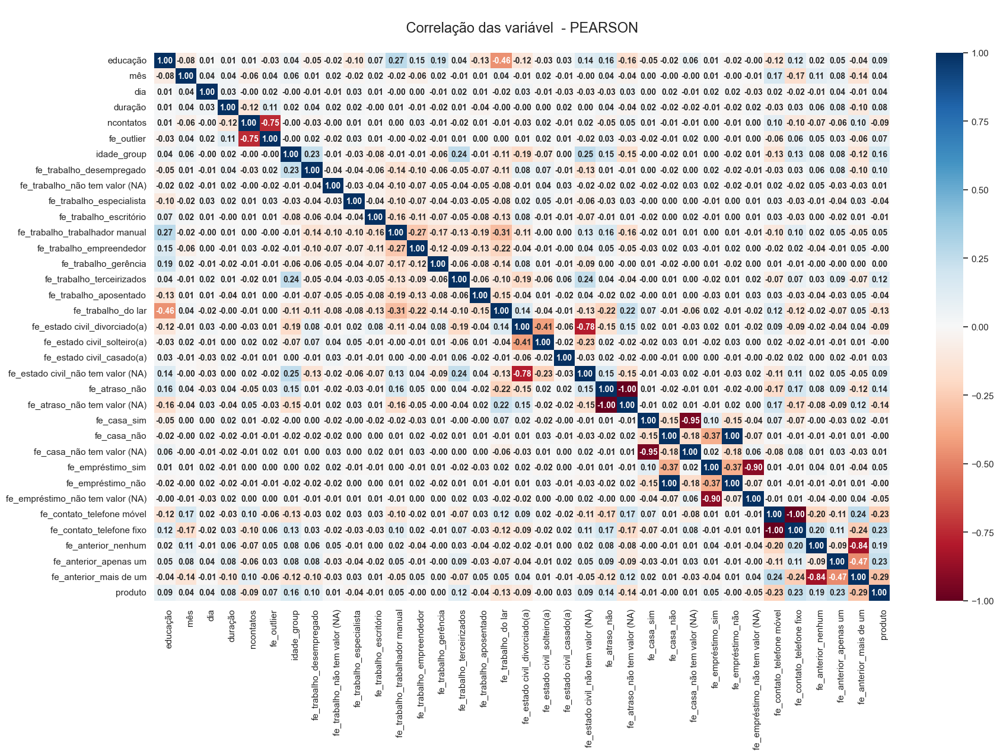

Variáveis autocorrelacionadas threshold=0.80


,var_1,var_2,corr
0,fe_atraso_não,fe_atraso_não tem valor (NA),-1.00000
1,fe_atraso_não tem valor (NA),fe_atraso_não,-1.00000
2,fe_casa_sim,fe_casa_não tem valor (NA),-0.94569
3,fe_casa_não tem valor (NA),fe_casa_sim,-0.94569
4,fe_empréstimo_sim,fe_empréstimo_não tem valor (NA),-0.90240
5,fe_empréstimo_não tem valor (NA),fe_empréstimo_sim,-0.90240
6,fe_contato_telefone móvel,fe_contato_telefone fixo,-1.00000
7,fe_contato_telefone fixo,fe_contato_telefone móvel,-1.00000
8,fe_anterior_nenhum,fe_anterior_mais de um,-0.83799
9,fe_anterior_mais de um,fe_anterior_nenhum,-0.83799


In [1006]:
sns.set(style="whitegrid", palette="pastel")
plt.figure(figsize=(20,12))

col = _.filter(regex=r'fe_id').columns.to_list() + [target]
_   = X_train.copy()
_[target] = y_train
#_.drop(feature_drop, axis=1, inplace=True)

utility.graf_feature_corr(df_         = _, 
                        annot_      = True, 
                        threshold_  = .8, 
                        print_var_  = True, 
                        print_graf_ = True, 
                        mask_       = False);

In [945]:
feature_drop = ['fe_atraso_não tem valor (NA)', 'fe_contato_telefone móvel', 'fe_anterior_nenhum', 
                'fe_casa_não tem valor (NA)', 'fe_empréstimo_não tem valor (NA)'
               ]

## 3.3. Treinamento

In [1078]:
def delete_files(namefile):
                
        path = ['model/train', 'model/test', 'model/valid', 'model/params', 'model/score',
                'model/test_f', 'model/cv_model', 'model/preds', 'model/optuna', 
                'model/preds/train', 'model/preds/test', 'model/preds/test/n1', 
                'model/preds/test/n2', 'model/preds/test/n3', 'model/preds/train/n1', 
                'model/preds/train/n2', 'model/preds/train/n3','model/preds/param', 
                'Data/submission/tunning', 'Data/submission', 'model/mdl'                
               ]

        for path_ in path:
            for raiz, diretorios, arquivos in os.walk(path_):
                for arquivo in arquivos:
                    if arquivo.startswith(namefile):
                        os.remove(os.path.join(raiz, arquivo))

In [1138]:
def print_graf_evals_result(model_, y_pred_tr_proba, y_pred_vl_proba): 
    
    results     = model_.evals_result()
    ntree_limit = model_.best_ntree_limit

    plt.figure(figsize=(20,9))
    plt.subplot(1,2,1)
    plt.plot(results["validation_0"]['error'], label="Treinamento")
    plt.plot(results["validation_1"]['error'], label="Validação")
    plt.title('Erro', fontsize=20)
    plt.legend()

    plt.subplot(1,2,2)
    plt.plot(results["validation_0"]['logloss'], label="Treinamento")
    plt.plot(results["validation_1"]['logloss'], label="Validação")
    plt.title('Log Loss', fontsize=20)

    plt.axvline(ntree_limit, color="gray", label="N. de árvore ideal {}".format(ntree_limit))

    plt.xlabel('Número de árvores')
    plt.ylabel(erro)
    plt.legend();

    plt.suptitle('Performance XGB', y=1.01, fontsize=24);
    plt.tight_layout(h_pad=3.0);
    
    fig, axs = plt.subplots(1, 2, figsize=(20, 7)) 

    axs[0].hist(y_pred_tr_proba, range=(0, 1), bins=100, density=True, color='#ffd700', label='Traino')
    axs[0].hist(y_pred_vl_proba, range=(0, 1), bins=100, density=True, color='#0057b8', label='Teste')
    axs[0].set_title('', fontsize=16)
    axs[0].legend()

    CalibrationDisplay.from_predictions(y_train, y_pred_tr_proba, ax=axs[1], n_bins=20, strategy='quantile', color='b')
    axs[1].set_title('Probability calibration')
    axs[1].set_xlabel('')
    axs[1].set_ylabel('')

    plt.suptitle('Distribuição e calibração dos modelos', fontsize=20)
    plt.tight_layout(pad=3.0);



In [938]:
cols = X_valid.columns.to_list()
cols_model_1 = cols

In [940]:
counter          = Counter(y_train)
scale_pos_weight = (counter[0]/counter[1]) 

F1-score: 0.70100 - F1-tr: 0.73052 - AUC: 0.77838 - L. Loss: 7.95011 => StandardScaler()
0.7936842105263158
CPU times: total: 9.23 s
Wall time: 1.51 s


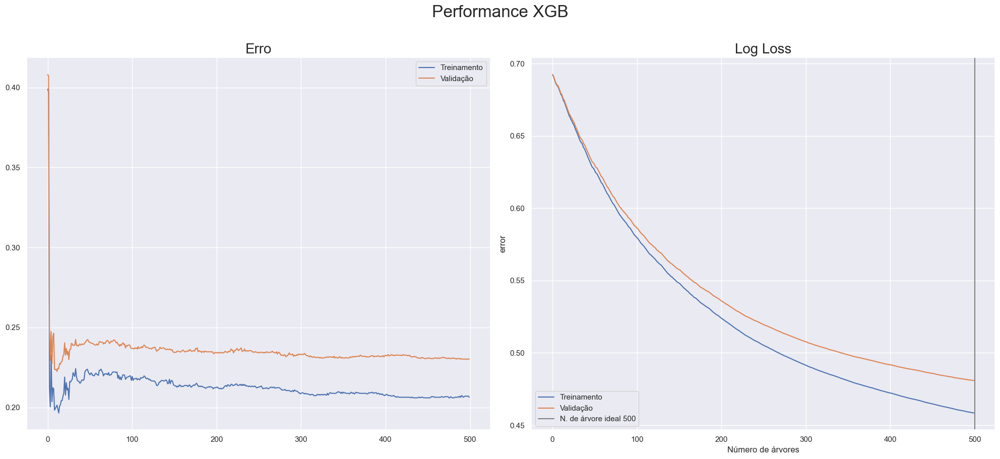

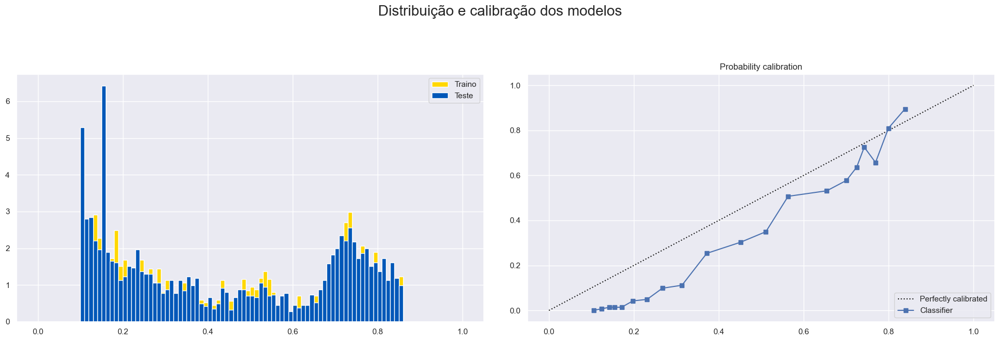

In [1156]:
%%time 
seed        = 12359
erro        = 'error'
params_xgb  = {
    'objective'        : 'binary:logistic', 
    'eval_metric'      : ['error', 'logloss'], #logloss 
    'max_depth'        : 4, 
    'scale_pos_weight' : scale_pos_weight,
    'n_estimators'     : 500,    
    'learning_rate'    : .007,
    'colsample_bytree' : .75,    
    'subsample'        : .8,
    'reg_lambda'       : 50,
    'n_jobs'           : -1,    
    'seed'             : seed}
    
if torch.cuda.is_available():           
    params_xgb.update({'tree_method': 'gpu_hist','predictor': 'gpu_predictor'})

scalers = [#None, 
           StandardScaler(),
           #RobustScaler()
          ]

scaler_dammy = MaxAbsScaler()

scaler_best    = None
model_best     = None
score_best     = np.mean(y)
cols           = ['educação','mês','dia','duração','ncontatos','fe_outlier','idade_group'] 
feature_dammy  = X_train.filter(regex=r'fe_').columns.to_list()

for i , scaler in enumerate(scalers): 
    
    model_baseline = xgb.XGBClassifier(**params_xgb)
    n_estimators   = int(model_baseline.get_params()['n_estimators']*.1)
    
    X_train_s = X_train.drop(feature_drop, axis=1).copy()
    X_valid_s = X_valid.drop(feature_drop, axis=1).copy()
    X_test_s  = X_test.drop(feature_drop, axis=1).copy()
        
    if scaler!=None:                      
        X_train_s[cols] = scaler.fit_transform(X_train_s[cols])
        X_valid_s[cols] = scaler.transform(X_valid_s[cols])
        X_test_s[cols]  = scaler.transform(X_test[cols])        
            
    eval_set = [(X_train_s, y_train), (X_valid_s, y_valid)]
    
    model_baseline.fit(X_train_s, 
                       y_train, 
                       eval_set  = eval_set,                                               
                       verbose   = False, 
                       early_stopping_rounds = int(n_estimators*.3))

    score_tr  = model_baseline.score(X_train_s, y_train)  
    y_pred_tr_proba = model_baseline.predict_proba(X_train_s, ntree_limit=model_baseline.best_ntree_limit)[:,1]
    y_pred_vl_proba = model_baseline.predict_proba(X_valid_s, ntree_limit=model_baseline.best_ntree_limit)[:,1]
    y_pred_ts       = model_baseline.predict(X_test_s,  ntree_limit=model_baseline.best_ntree_limit)
    
    y_pred_tr = (y_pred_tr_proba>.5).astype(int)
    y_pred_vl = (y_pred_vl_proba>.5).astype(int)
    
    f1_tr = metrics.f1_score(y_train, y_pred_tr)
    f1    = metrics.f1_score(y_valid, y_pred_vl)
    auc   = metrics.roc_auc_score(y_valid, y_pred_vl)
    lloss = metrics.log_loss(y_valid, y_pred_vl) 

    msg = 'F1-score: {:2.5f} - F1-tr: {:2.5f} - AUC: {:2.5f} - L. Loss: {:2.5f} => {}'     
    print(msg.format(f1, f1_tr, auc, lloss, scaler ))

print(score_tr)

print_graf_evals_result(model_baseline, y_pred_tr_proba, y_pred_vl_proba)

# F1-score: 0.70143 - F1-tr: 0.73187 - AUC: 0.77843 - L. Loss: 7.84103 => StandardScaler()

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
O modelo não é muito bom, tem overfitting. Temos que fazer um tunnint dos parametos. 
    
</div>

## 3.4. Tunning

In [1158]:
df3_train = df2_train.copy()
df3_test  = df2_test.copy()

X_      = df3_train.drop(target, axis=1)
y      = df3_train[target].map({'sim':1, 'não':0})
X_test = df3_test

X_feature = bin_idade(X_)
X_test    = bin_idade(X_test)

X_feature , _, X_test = feature_binarizer(X_feature, X_feature, X_test, cols_oho, cols_ord)

In [ ]:
%%time 

params_xgb  = {
    'max_depth'        : [2, 4, 5, 7],
    'n_estimators'     : [50, 100, 200, 300, 500, 1000],    
    'colsample_bytree' : [.5, .65, .7, .75, .8 ],
    'learning_rate'    : [.1, .01, .007, .03, .003],
    'subsample'        : [.6, .7, .8, .9],
    'reg_lambda'       : [10, 20, 50, 100]
    }
        
model_xgb = xgb.XGBClassifier(
    objective        = 'binary:logistic', 
    eval_metric      = 'logloss',
    scale_pos_weight = scale_pos_weight,
    use_label_encoder= False, 
    tree_method      = 'gpu_hist',
    predictor        = 'gpu_predictor', 
    random_state     = seed
)

# Usando o constructor para criar o objeto sss
sss = StratifiedShuffleSplit(n_splits     = 5,       # 20 simulações.
                             test_size    = 0.2,     # 20% do dataset será de testes.
                             random_state = seed)   # Permitir a reprodutibilidade.


# Criando um dicionário com as métricas que desejo calcular.
meus_scores = {'accuracy' : make_scorer(accuracy_score),
               'recall'   : make_scorer(recall_score),
               'precision': make_scorer(precision_score),
               'f1'       : make_scorer(fbeta_score, beta=1), 
               'logloss'  : make_scorer(log_loss)}


gs_xgb =  GridSearchCV(estimator          = model_xgb, 
                       param_grid         = params_xgb, 
                       scoring            = meus_scores,
                       refit              = 'f1',
                       cv                 = sss, 
                       return_train_score = True,
                       n_jobs             = -1,
                      )

scaler=StandardScaler()

X_feature_sc = scaler.fit_transform(X_feature)

gs_xgb.fit(X_feature_sc, y)
print("Best parameters for XGBoost:", gs_xgb.best_params_)

In [997]:
pd.DataFrame(gs_xgb.cv_results_).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_n_estimators,params,split0_test_accuracy,split1_test_accuracy,split2_test_accuracy,split3_test_accuracy,split4_test_accuracy,mean_test_accuracy,std_test_accuracy,rank_test_accuracy,split0_train_accuracy,split1_train_accuracy,split2_train_accuracy,split3_train_accuracy,split4_train_accuracy,mean_train_accuracy,std_train_accuracy,split0_test_recall,split1_test_recall,split2_test_recall,split3_test_recall,split4_test_recall,mean_test_recall,std_test_recall,rank_test_recall,split0_train_recall,split1_train_recall,split2_train_recall,split3_train_recall,split4_train_recall,mean_train_recall,std_train_recall,split0_test_precision,split1_test_precision,split2_test_precision,split3_test_precision,split4_test_precision,mean_test_precision,std_test_precision,rank_test_precision,split0_train_precision,split1_train_precision,split2_train_precision,split3_train_precision,split4_train_precision,mean_train_precision,std_train_precision,split0_test_f1,split1_test_f1,split2_test_f1,split3_test_f1,split4_test_f1,mean_test_f1,std_test_f1,rank_test_f1,split0_train_f1,split1_train_f1,split2_train_f1,split3_train_f1,split4_train_f1,mean_train_f1,std_train_f1
0,1.622306,0.074604,0.020189,0.001907,2,50,"{'max_depth': 2, 'n_estimators': 50}",0.799123,0.789474,0.773684,0.803509,0.790351,0.791228,0.010245,11,0.802193,0.799342,0.802851,0.793640,0.796711,0.798947,0.003438,0.825858,0.831135,0.823219,0.873351,0.868074,0.844327,0.021758,6,0.845089,0.847067,0.847067,0.847726,0.847726,0.846935,0.000969,0.657563,0.641548,0.620278,0.652860,0.635135,0.641477,0.013251,19,0.657773,0.652947,0.658299,0.644289,0.648840,0.652430,0.005337,0.732164,0.724138,0.707483,0.747178,0.733556,0.728904,0.013021,8,0.739758,0.737446,0.740848,0.732138,0.735067,0.737051,0.003161
1,1.429542,0.679933,0.025262,0.009053,2,100,"{'max_depth': 2, 'n_estimators': 100}",0.800000,0.790351,0.777193,0.810526,0.794737,0.794561,0.010990,6,0.803947,0.802412,0.810088,0.802851,0.806579,0.805175,0.002851,0.831135,0.833773,0.828496,0.865435,0.868074,0.845383,0.017550,5,0.853659,0.854977,0.858273,0.854977,0.856295,0.855636,0.001560,0.657620,0.642276,0.624254,0.665314,0.641326,0.646158,0.014259,17,0.658363,0.655713,0.666667,0.656377,0.661742,0.659772,0.004035,0.734266,0.725603,0.712018,0.752294,0.737668,0.732370,0.013331,5,0.743398,0.742203,0.750432,0.742628,0.746552,0.745043,0.003096
2,1.334257,0.105562,0.033921,0.005371,2,200,"{'max_depth': 2, 'n_estimators': 200}",0.805263,0.792105,0.781579,0.815789,0.795614,0.798070,0.011656,1,0.810088,0.808553,0.819298,0.810088,0.813596,0.812325,0.003860,0.836412,0.836412,0.839050,0.886544,0.868074,0.853298,0.020479,2,0.860910,0.860910,0.874753,0.862887,0.873434,0.866579,0.006192,0.664570,0.644309,0.628458,0.667992,0.642578,0.649582,0.014742,13,0.665987,0.663618,0.676696,0.665480,0.668180,0.667992,0.004588,0.740654,0.727899,0.718644,0.761905,0.738496,0.737520,0.014521,1,0.751006,0.749498,0.763082,0.751435,0.757143,0.754433,0.005045
3,2.039538,0.072065,0.045421,0.016022,2,300,"{'max_depth': 2, 'n_estimators': 300}",0.804386,0.793860,0.776316,0.810526,0.792982,0.795614,0.011677,4,0.815132,0.815132,0.821930,0.815351,0.817982,0.817105,0.002643,0.836412,0.833773,0.836412,0.875989,0.857520,0.848021,0.016401,3,0.870798,0.870798,0.878708,0.877390,0.872775,0.874094,0.003335,0.663180,0.647541,0.621569,0.662675,0.641026,0.647198,0.015427,16,0.671240,0.671240,0.679755,0.669854,0.675166,0.673451,0.003617,0.739790,0.728950,0.713161,0.754545,0.733634,0.734016,0.013532,3,0.758106,0.758106,0.766532,0.759703,0.761357,0.760761,0.003127
4,3.500618,0.152016,0.031912,0.003792,2,500,"{'max_depth': 2, 'n_estimators': 500}",0.807018,0.792105,0.784211,0.809649,0.796491,0.797895,0.009425,2,0.821272,0.824123,0.829825,0.824781,0.826096,0.825219,0.002791,0.836412,0.823219,0.839050,0.875989,0.854881,0.845910,0.018096,4,0.877390,0.887278,0.889255,0.883982,0.883322,0.884245,0.004055,0.667368,0.647303,0.632207,0.661355,0

## 3.3. Anállise
Vamos começa plotando os valores real x preditos. 

### 3.3.3. SHAP Values
Para uma análise detralhada das previsões vamos utilizar o **SHAP (SHapley Additive exPlanations)**, é uma técnica usada para interpretar os "black-box models" para explicar a saída de qualquer modelo de Machine Learning, com ele podemos ter uma maior explicabilidade dos impactos das variáveis nas predições.  <p>
        
O **SHAP mede o impacto das variáveis, levando em consideração a interação com outras variáveis**, é verificado a importância de uma variável comparando o que um modelo prevê com e sem a variável, isso é feito em todas as ordens possíveis, para que as variáveis sejam comparadas de maneira justa. 

Desenvolvido por [Scott M. Lundberg.](https://scottlundberg.com/)

    

#### 3.3.3.1. Explainer 

In [799]:
#explainer   = shap.TreeExplainer(model_baseline)
#shap_values = explainer(X_train_best)

explainer   = shap.Explainer(model_baseline)
shap_values = explainer(X_train_s) 

#### 3.3.3.2. Featuere Importance

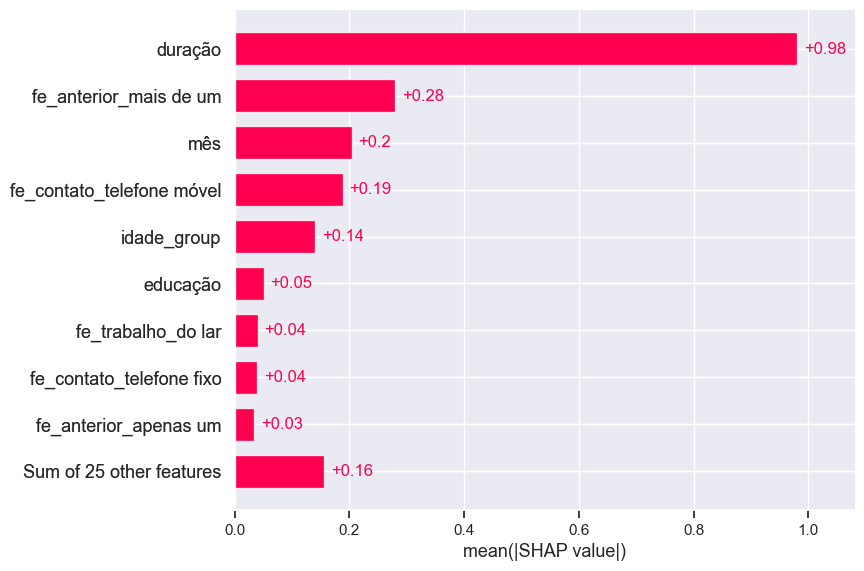

In [800]:
shap.plots.bar(shap_values, max_display=10)

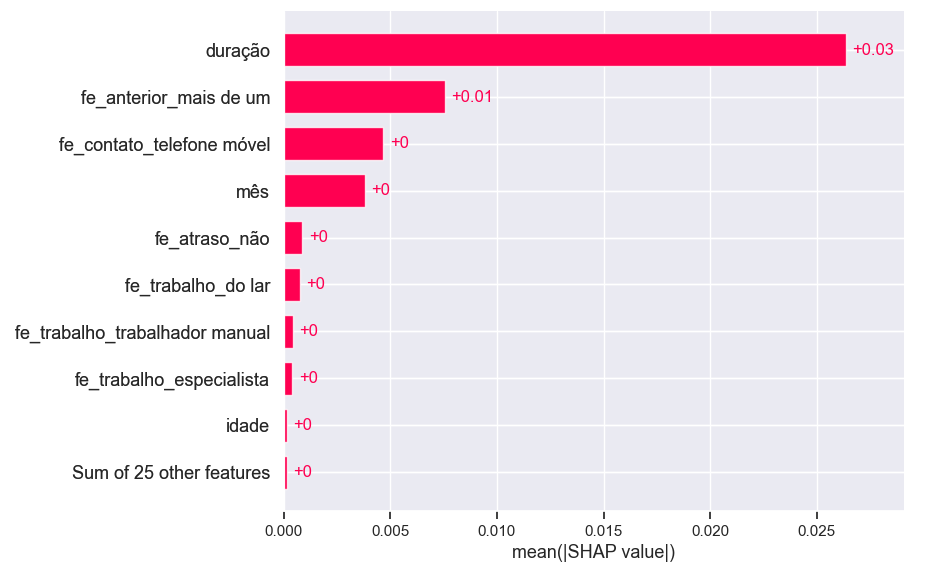

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>

O gráfico de importância das variáveis mostra que as variáveis: <b>umidade, temperatura e sol</b>, são os três principais fatores que impulsionam as previsões do modelo, um destaque maior para <b>umidade</b>. A primeira impressão, parece um resultado que faz sentido, pois nas análises (EDA) que fizemos essas variáveis se mostravam promissoras e se destacam, são três variáveis que podemos trabalhar para melhorar o desempenho dos modelos na <b>Engenharia de Recursos</b>.  <p> <br>       
    
    
Vamos dar uma olhada no comportamento dos grupos de variáveis.     
</div>

35it [00:11,  2.87s/it]                                                                                                


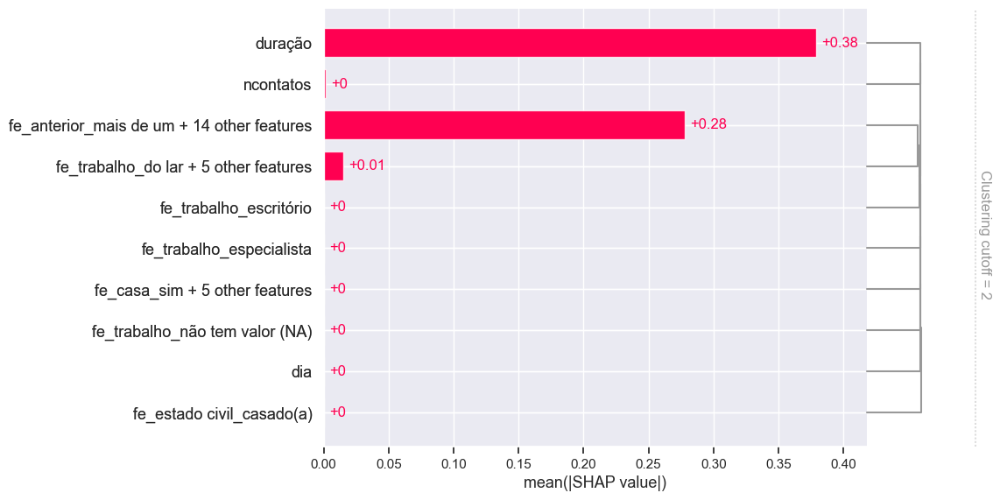

In [116]:
cluster = shap.utils.hclust(X_train_s, y_train) #, linkage='single') 
shap.plots.bar(shap_values, clustering=cluster, clustering_cutoff=2, merge_cohorts=True);

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>
 
No gráfico acima temos alguns clustering de variáveis qua aumentam a participação na predição do modelo, isso nos dar uma idéia de como podemos criar novas variáveis que pondem ajudar no desempenho do modelo, podemos descatar as variáveis <b>fe_feriado_não e fe_feriado_sim</b> que foram transformadas <b>one hot conding</b>, elas individualmente tem um valor baixo em relação a junção dessas variáveis. 
</div>

#### 3.3.3.3. Impacto da variável 

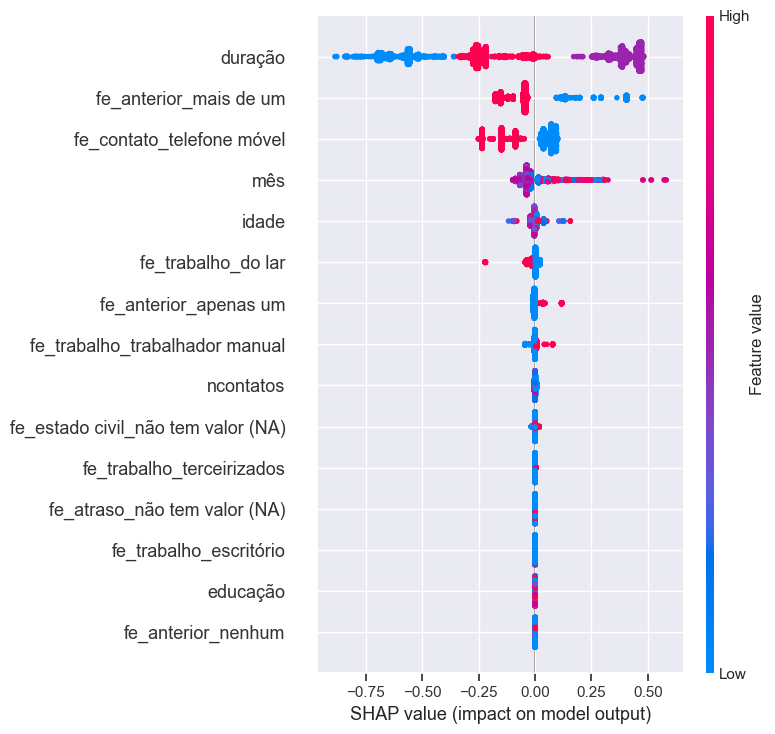

In [118]:
shap.summary_plot(shap_values, X_train_s, max_display=15)

<div class="alert alert-block alert-info" style="border-radius:15px">
<p style="color: black; font-family: Arial Black">NOTA:</p>

Acima observamos que a **umidade** afeta as previsões negativamente, <b>temperatura, sol e hora</b> são variáveis que tem impacto positivo nas previsões, com um destaque para a variável <b>sol</b> que tem uma pequena parcela da amostra que afeta negativamente as previsões, a descritização dessa variável pode ser uma solução de melhoria.     
    
</div>

#### 3.3.3.4. Gráfico de força coletiva
  
O trecho de código abaixo é demorado, em grandes bases de dados devemos trabalhar com uma amostra. 

In [ ]:
%%time 

# shap.initjs()
#shap.force_plot(shap_values, shap_values, X_train_s)

Vamos dar uma olhada na variável temperatura. 

In [ ]:
explainer   = shap.TreeExplainer(model_baseline)
shap_values = explainer.shap_values(X_train_s)

col       = 'idade'
inds      = shap.approximate_interactions(col, shap_values, X_train_best)
fig, axes = plt.subplots(5,2,figsize=(20,30))
axes      = axes.ravel()

for i in range(10):    
    shap.dependence_plot(col, shap_values, X_train_best, 
                         interaction_index=inds[i], ax=axes[i], show=False)

## 3.4. Validação Cruzada

<div class="alert alert-block alert-info">

Na validação cruzada neste primeiro momento, vamos treinar o modelo com 80% dos dados e 20% será utilizado para medir a performance do modelo em dados não visto no treinamento, vamos fazer o treinamento de 5 e 10 folds e fazer uma pequena análise. 
    
    
</div>

In [178]:
def save_data_model(model_, model_name_, path_, df_, y_pred_test_prob_, y_pred_test_subm_, score_, 
                    seed_, level_='1', target_='target', cutoff_value_=.6, gera_submission_=True):    
    
    level = 'n' + level_ + '/'

    if score_>cutoff_value_:    
        
        path_name_param = path_ + 'model/preds/param/' + model_name_.format(score_, seed_) + '.pkl.z'
        path_name_train = path_ + 'model/preds/train/' + level + model_name_.format(score_, seed_) + '.pkl.z'
        path_name_test  = path_ + 'model/preds/test/'  + level + model_name_.format(score_, seed_) + '.pkl.z'   
        path_name_model = path_ + 'model/mdl/'         + model_name_.format(score_, seed_) + '.pkl.z'   
        
        delete_files(model_name_)
        
        jb.dump(df_, path_name_train)
        jb.dump(y_pred_test_prob_, path_name_test)
        jb.dump(model_, path_name_model)
                
        if gera_submission_:
            model_name_ = model_name_.format(score_, seed_)
            df_submission[target] = y_pred_test_subm_
            df_submission.to_csv(path_ + 'Data/submission/' + model_name_+ '.csv', index=False)

In [179]:
def save_data_model(model_, model_name_, path_, df_, y_pred_test_prob_, y_pred_test_subm_, score_, 
                    seed_, level_='1', target_='target', cutoff_value_=.6, gera_submission_=True):    
    
    level = 'n' + level_ + '/'

    if score_>cutoff_value_:    
        
        path_name_param = path_ + 'model/preds/param/' + model_name_.format(score_, seed_) + '.pkl.z'
        path_name_train = path_ + 'model/preds/train/' + level + model_name_.format(score_, seed_) + '.pkl.z'
        path_name_test  = path_ + 'model/preds/test/'  + level + model_name_.format(score_, seed_) + '.pkl.z'   
        path_name_model = path_ + 'model/mdl/'         + model_name_.format(score_, seed_) + '.pkl.z'   
        
        delete_files(model_name_)
        
        jb.dump(df_, path_name_train)
        jb.dump(y_pred_test_prob_, path_name_test)
        jb.dump(model_, path_name_model)
                
        if gera_submission_:
            model_name_ = model_name_.format(score_, seed_)
            df_submission[target] = y_pred_test_subm_
            df_submission.to_csv(path_ + 'Data/submission/' + model_name_+ '.csv', index=False)

In [180]:
def df_return_preds_stacking(model_name_=None, path_='', target_='target', level=1): 

    if level==1: 
        level_ = 'n1'
    else: 
        if level==2:
            level_ = 'n2'
        else: 
            level_ = 'n3'

    paths = ['model/preds/test/'+ level_, 'model/preds/train/' + level_ ]    

    if model_name_==None: 
        model_name_=''

    for i, p in enumerate(paths): 

        p = path_ + p 

        name_file_pkl     = glob.glob(p + '/'+ model_name_ + '*.pkl.z')
        dic_preds_mdl_pkl = dict()    

        for p_name in name_file_pkl:    
            y_model_pkl_name_col  = p_name.replace(p + '\\', '').replace('.pkl.z','') 
            #y_model_pkl           = jb.load(p_name)
            df_pkl =jb.load(p_name)

            if i==0: 
                x_proba = df_pkl
            else: 
                x_proba = df_pkl['y_proba']        

            dic_preds_mdl_pkl[y_model_pkl_name_col] = x_proba

        if i==0:
            df_ts = pd.DataFrame(dic_preds_mdl_pkl)
        else: 
            df_tr = pd.DataFrame(dic_preds_mdl_pkl) 
            df_tr[target_] = df_pkl['y_proba']
            
    return df_tr, df_ts 

In [359]:
def cross_val_model(model_, model_name_, X_, y_, X_test_, target_, scalers_, lb_, fold_=5, path_='',  
                    seed_=12359, feature_scaler_=None, print_report_=False, save_submission_=False, 
                    save_predict_=False, level_='1', cutoff_value_save_=.6, 
                    train_with_created_folds_=False):
    
    n_estimators    = model_.get_params()['n_estimators']             
    valid_preds     = {}
    taco            = 90 
    acc_best        = 0  
    df_preds        = pd.DataFrame()
    feature_imp     = pd.DataFrame()
    test_preds      = []
    preds           = []
    model           = []
    folds           = []
    cols_sencond_level = ['fold', 'idx_fold', 'y', 'y_pred', 'residuo']
    
    for i, scaler_ in enumerate(scalers_):
        
        # Recuperar os indices do kf 
        if train_with_created_folds_:
            for i in range(fold_):         
                folds.append(jb.load(path + 'model/preds/folds/kf_folds_{}_{}.pkl.z'.format(fold_, i+1)))
        else:
            #folds = KFold(n_splits=fold_, shuffle=False, random_state=seed_)
            folds = StratifiedKFold(n_splits=fold_, shuffle=True, random_state=seed_)
            folds = folds.split(X_, y_)

        time_start  = datetime.now()
        score     = [] 
        score_tr  = [] 
        score_mae = []
                
        if scaler_!=None:            
            string_scaler = str(scaler_)        
            string_scaler = string_scaler[:string_scaler.index('(')]
        else:
            string_scaler = None 
            
        y_pred_test = np.zeros(len(X_test_))        
        
        print('='*taco)
        print('Scaler: {} - n_estimators: {}'.format(string_scaler, n_estimators))
        print('='*taco)
        
        y_pred_test_oof = 0      
        second_level    = np.zeros((X_.shape[0], 5))        

        for fold, (trn_idx, val_idx) in enumerate(folds): 

            time_fold_start = datetime.now()
            
            if train_with_created_folds_:
                trn_idx = folds[fold][trn_idx]
                val_idx = folds[fold][val_idx]
            
            # ---------------------------------------------------- 
            # Separar dados para treino 
            # ----------------------------------------------------     
            X_trn, X_val = X_.iloc[trn_idx], X_.iloc[val_idx]
            y_trn, y_val = y_.iloc[trn_idx], y_.iloc[val_idx] 
            
            counter = Counter(y_trn)
            scale_pos_weight = (counter[0]/counter[1]) 

            # ---------------------------------------------------- 
            # Processamento 
            # ---------------------------------------------------- 
            X_tst = X_test_.copy()
            
            if scaler_!=None: 
                if feature_scaler_!=None:                     
                    X_trn[feature_scaler_] = scaler_.fit_transform(X_trn[feature_scaler_].values)
                    X_val[feature_scaler_] = scaler_.transform(X_val[feature_scaler_].values)                       
                    X_tst[feature_scaler_] = scaler_.transform(X_tst[feature_scaler_].values) 
                else:                               
                    X_trn = scaler_.fit_transform(X_trn)
                    X_val = scaler_.transform(X_val)
                    X_tst = scaler_.transform(X_tst.copy())
                
            # ---------------------------------------------------- 
            # Treinar o modelo 
            # ----------------------------------------------------
            
            model_.set_params(**{'scale_pos_weight':scale_pos_weight})
            
            model_.fit(X_trn, y_trn,
                       eval_set              = [(X_trn, y_trn), (X_val, y_val)],          
                       early_stopping_rounds = int(n_estimators*.1),
                       verbose               = False)
            
            # ---------------------------------------------------- 
            # Predição 
            # ----------------------------------------------------                 
            y_pred_val       = model_.predict(X_val, ntree_limit=model_.best_ntree_limit)
            y_pred_tr        = model_.predict(X_trn, ntree_limit=model_.best_ntree_limit)
            y_pred_test_oof += model_.predict(X_tst, ntree_limit=model_.best_ntree_limit) / fold_
                        
            second_level[val_idx, 0] = fold+1 
            second_level[val_idx, 1] = val_idx 
            second_level[val_idx, 2] = y_val.values
            second_level[val_idx, 3] = y_pred_val 
            second_level[val_idx, 4] = np.int64(y_val.values - y_pred_val) 
            
            # ---------------------------------------------------- 
            # Score 
            # ----------------------------------------------------                         
            #rmse, mae, mse, mape, r_squared = ul.evaluation(y_val, y_pred_val)  
            
            f1    = metrics.f1_score(y_val, y_pred_val)
            auc   = metrics.roc_auc_score(y_val, y_pred_val)
            lloss = metrics.log_loss(y_val, y_pred_val)
            
            f1_tr = metrics.f1_score(y_trn, y_pred_tr)
            
            score.append(f1)    
            score_tr.append(f1_tr)
            score_mae.append(f1)
            
            # ---------------------------------------------------- 
            # Feature Importance
            # ----------------------------------------------------             
            feat_imp = pd.DataFrame(index   = X_.columns,
                                    data    = model_.feature_importances_,
                                    columns = ['fold_{}'.format(fold+1)])

            feat_imp['f1_'+str(fold+1)] = f1
            feature_imp = pd.concat([feature_imp, feat_imp], axis=1)
            
            # ---------------------------------------------------- 
            # Print resultado  
            # ---------------------------------------------------- 
            time_fold_end = utility.diff(time_fold_start, datetime.now())
            msg = '[Fold {}] F1-score: {:2.5f} - F1-Train: {:2.5f}  - AUC: {:2.5f} - L.Loss: {:2.5f}- {}'
            print(msg.format(fold+1, f1, f1_tr, auc, lloss, time_fold_end))
            
            # ---------------------------------------------------- 
            # Salvar o modelo 
            # ---------------------------------------------------- 
            dic_model = {'scaler' : scaler_, 
                         'fold'   : fold+1, 
                         'model'  : model_ }
            
            model.append(dic_model)
        
        df_preds           = pd.DataFrame(second_level, columns=cols_sencond_level)
        df_preds['scaler'] = string_scaler
        
        for col in ['fold', 'idx_fold', 'y', 'y_pred']:
            df_preds[col] = df_preds[col].astype(np.int)
        
        score_mean     = np.mean(score) 
        score_std      = np.std(score)
        score_mae_mean = np.mean(score_mae)
        scaore_tr_mean = np.mean(score_tr)
        
        if score_mean > acc_best:     
            acc_best    = score_mean           
            model_best  = model_    
            scaler_best = scaler_

        time_end = utility.diff(time_start, datetime.now())   

        msg ='[Mean Fold] F1-score: {:2.5f} std: {:2.5f} - F1-Train {:2.5f} - L.Loss {:2.5f} - {}'
        
        print('-'*taco)        
        print(msg.format(score_mean,score_std,  scaore_tr_mean,  score_mae_mean,time_end))
        print('='*taco)
        print()
                                         
        # Salvar as predições
        if save_submission_:        
            y_pred_test_oof = np.int64(y_pred_test_oof)
            save_data_model(model_             = model_, 
                            model_name_        = model_name_+'_score_{:2.5f}_seed_{}_'+str(scaler_).lower()[:4], 
                            path_              = path_,                             
                            df_                = df_preds,          # stacking
                            y_pred_test_prob_  = y_pred_test_oof,   # stacking 
                            y_pred_test_subm_  = y_pred_test_oof,   # sumission 
                            score_             = score_mean, 
                            seed_              = seed_, 
                            level_             = level_, 
                            target_            = target_, 
                            cutoff_value_      = cutoff_value_save_) 
            
    print('-'*taco)
    print('Scaler Best: {}'.format(scaler_best))
    print('Score      : {:2.5f}'.format(acc_best))
    print('-'*taco)
    print()
    
    utility.free_gpu_cache()
    
    return model, df_preds , feature_imp 

In [343]:
def create_kfolds(folds, X_, y_):

    kf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=12359)

    for fold, (trn_idx, val_idx) in enumerate(kf.split(X_, y_, groups=y_)):   
        idx  = {'trn_idx': trn_idx, 'val_idx': val_idx}
        file = path + 'model/preds/folds/kf_folds_{}_{}.pkl.z'.format(folds,fold+1)
        jb.dump(idx, file)
        print('Fold: {}'.format(fold+1))

### 3.4.1 Treinar com 5 Folds

In [344]:
create_kfolds(5, X, y)

Fold: 1
Fold: 2
Fold: 3
Fold: 4
Fold: 5


Scaler: RobustScaler - n_estimators: 500
[Fold 1] F1-score: 0.76739 - F1-Train: 0.75528  - AUC: 0.83522 - L.Loss: 5.87775- 0h 0m 0s
[Fold 2] F1-score: 0.70246 - F1-Train: 0.76261  - AUC: 0.78405 - L.Loss: 8.05919- 0h 0m 0s
[Fold 3] F1-score: 0.71264 - F1-Train: 0.75827  - AUC: 0.79182 - L.Loss: 7.57442- 0h 0m 0s
[Fold 4] F1-score: 0.71179 - F1-Train: 0.76941  - AUC: 0.79346 - L.Loss: 7.99860- 0h 0m 0s
[Fold 5] F1-score: 0.72360 - F1-Train: 0.76098  - AUC: 0.80254 - L.Loss: 7.45324- 0h 0m 0s
------------------------------------------------------------------------------------------
[Mean Fold] F1-score: 0.72358 std: 0.02291 - F1-Train 0.76131 - L.Loss 0.72358 - 0h 0m 4s

------------------------------------------------------------------------------------------
Scaler Best: RobustScaler()
Score      : 0.72358
------------------------------------------------------------------------------------------


F1-score: 0.71043 - AUC: 0.78699 - L.Loss: 7.80469
CPU times: total: 33.5 s
Wall time: 4.

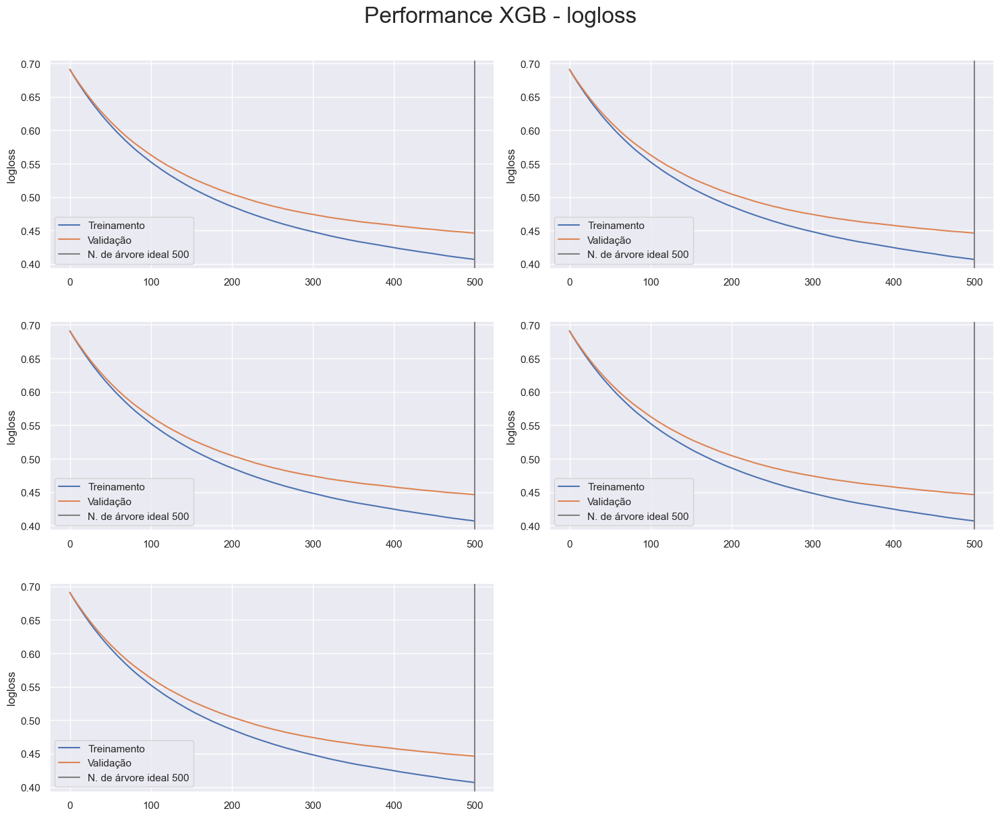

In [392]:
%%time 

seed        = 12359
eval_metric = ['logloss']                 
scalers     = [RobustScaler()]               

seed   = 12359
params_xgb  = {
    'objective'        : 'binary:logistic',
    'eval_metric'      : 'logloss', 
    'max_depth'        : 5, 
    #'scale_pos_weight' : scale_pos_weight,
    'n_estimators'     : 500,    
    'learning_rate'    : .005,
    'n_jobs'           : -1,
    
    'subsample'        : 0.7, 
    #'colsample_bytree' : 0.8, 
    'reg_alpha'        : 0.9,   
    'seed'             : seed}


if torch.cuda.is_available():           
    params.update({'tree_method': 'gpu_hist','predictor': 'gpu_predictor'})
    
model_name = 'xgb_02_cv_05_folds'

delete_files(model_name)

model_kf5, df_preds_kf5, feature_imp_kf5 = \
    cross_val_model(model_           = xgb.XGBClassifier(**params_xgb),
                    model_name_      = model_name,
                    X_               = X_train,
                    y_               = y_train,
                    X_test_          = X_test,
                    target_          = target,
                    scalers_         = scalers,
                    fold_            = 5,
                    lb_              = None,
                    path_            = path,
                    seed_            = seed, 
                    feature_scaler_  = None,                     
                    save_submission_ = True, 
                    #train_with_created_folds_ = True
                   )
print()

cols  = feature_imp_kf5.filter(regex=r'fold').columns.to_list()
folds = len(cols)
row   = int(folds/2+1)

for erro in eval_metric:
    
    plt.figure(figsize=(15,12))

    for i in range(len(model_kf5)):
        results     = model_kf5[i]['model'].evals_result() # merror
        ntree_limit = model_kf5[i]['model'].best_ntree_limit

        plt.subplot(row,2,i+1)
        plt.plot(results["validation_0"][erro], label="Treinamento")
        plt.plot(results["validation_1"][erro], label="Validação")

        plt.axvline(ntree_limit, 
                    color="gray", 
                    label="N. de árvore ideal {}".format(ntree_limit))

       # plt.xlabel('Número de árvores')
        plt.ylabel(erro)
        plt.legend();

    plt.suptitle('Performance XGB - {}'.format(erro), y=1.01, fontsize=24);
    plt.tight_layout(h_pad=3.0);
    
num_model  = 0
scaler_tr  = model_kf5[num_model]['scaler']
model_tr   = model_kf5[num_model]['model']
X_valid_sc = pd.DataFrame(scaler_tr.transform(X_valid), columns=X_valid.columns)

y_pred_val = model_tr.predict(X_valid_sc, ntree_limit=model_tr.best_ntree_limit)

f1 = metrics.f1_score(y_valid, y_pred_val)
auc= metrics.roc_auc_score(y_valid, y_pred_val)
lloss = metrics.log_loss(y_valid, y_pred_val) 

print('F1-score: {:2.5f} - AUC: {:2.5f} - L.Loss: {:2.5f}'.format(f1, auc, lloss))
# F1-score: 0.72360 - AUC: 0.79877 - L.Loss: 7.45323

# [Mean Fold] F1-score: 0.71147 std: 0.02447 - L.Loss 0.71147 - 0h 0m 3s
# [Mean Fold] F1-score: 0.72197 std: 0.02498 - L.Loss 0.72197 - 0h 0m 3s
# Score      : 0.72110 0.71390

F1-score: 0.71135 - AUC: 0.78731 - L.Loss: 7.67137


## 3.5. Análise do Modelo 

### 3.5.1. Feature Importances  

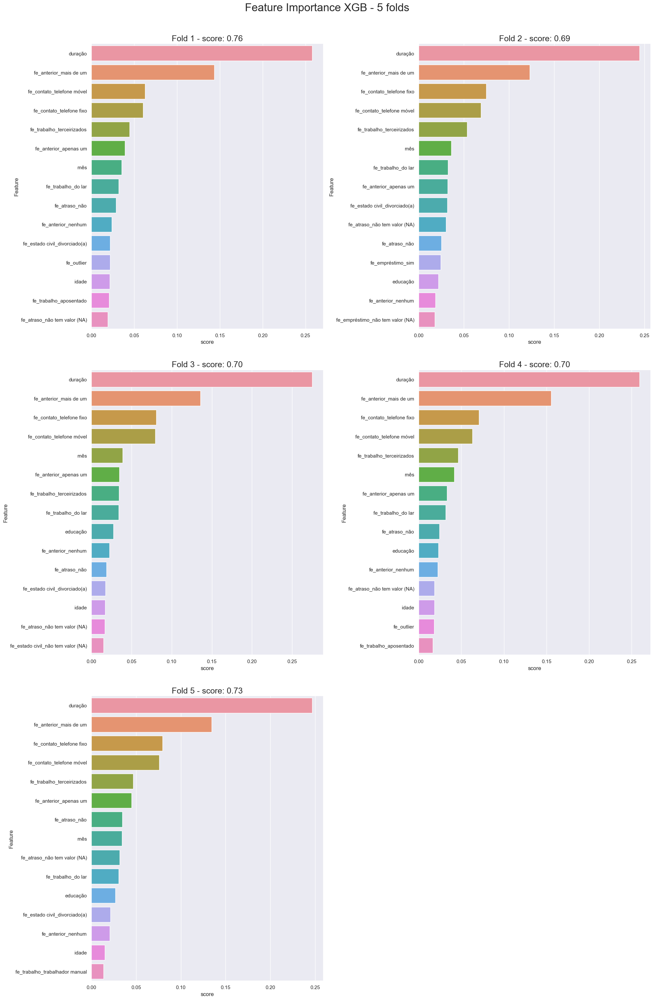

In [296]:
plt.figure(figsize=(20,30))

cols  = feature_imp_kf5.filter(regex=r'fold').columns.to_list()
folds = len(cols)
row   = int(folds/2+1)

for fold, col in enumerate(cols):            
    col_acc = 'f1_' + str(fold+1)
    df_fi = feature_imp_kf5.sort_values(by=col, ascending=False).reset_index().iloc[:15]
    df_fi = df_fi[['index', col, col_acc]]
    df_fi.columns = ['Feature', 'score', col_acc]
    plt.subplot(row, 2, fold+1)
    sns.barplot(x='score', y='Feature', data=df_fi)    
    plt.title('Fold {} - score: {:2.2f}'.format(fold+1, df_fi[col_acc].mean()), 
              fontdict={'fontsize':18})    

plt.suptitle('Feature Importance XGB - {} folds'.format(folds) , y=1.01, fontsize=24);
plt.tight_layout(h_pad=3.0); 

### 3.1.1. Erro e  número de Estimadores

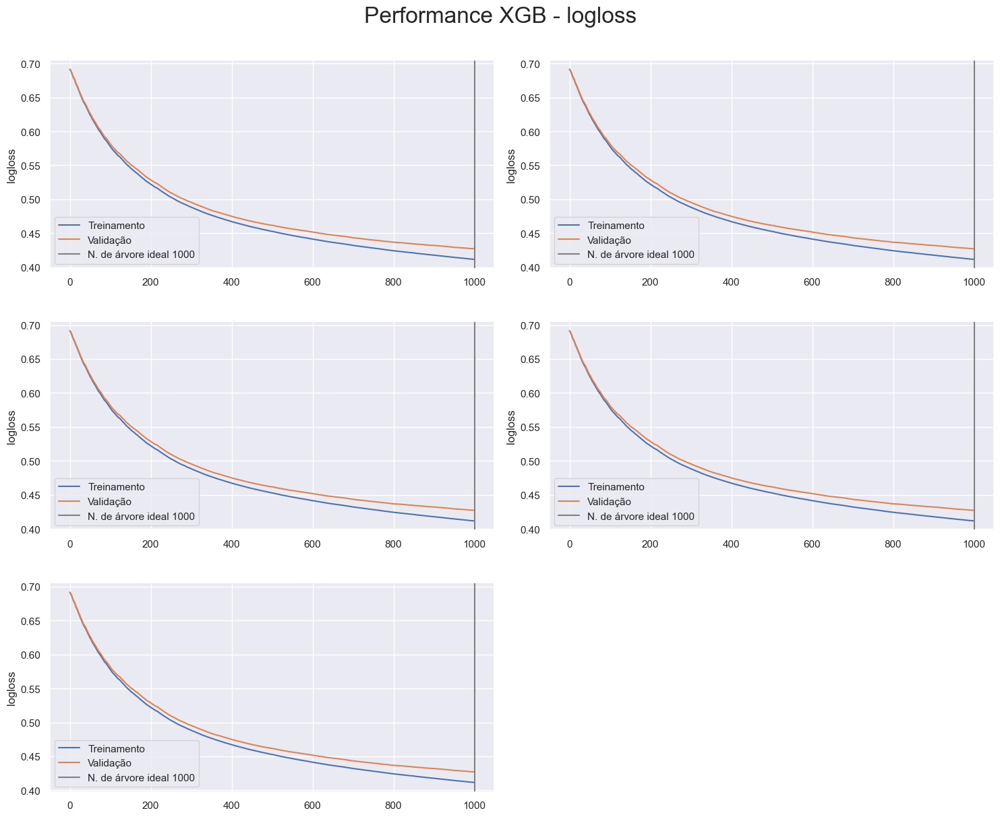

In [325]:
cols  = feature_imp_kf5.filter(regex=r'fold').columns.to_list()
folds = len(cols)
row   = int(folds/2+1)

for erro in eval_metric:
    
    plt.figure(figsize=(15,12))

    for i in range(len(model_kf5)):
        results     = model_kf5[i]['model'].evals_result() # merror
        ntree_limit = model_kf5[i]['model'].best_ntree_limit

        plt.subplot(row,2,i+1)
        plt.plot(results["validation_0"][erro], label="Treinamento")
        plt.plot(results["validation_1"][erro], label="Validação")

        plt.axvline(ntree_limit, 
                    color="gray", 
                    label="N. de árvore ideal {}".format(ntree_limit))

       # plt.xlabel('Número de árvores')
        plt.ylabel(erro)
        plt.legend();

    plt.suptitle('Performance XGB - {}'.format(erro), y=1.01, fontsize=24);
    plt.tight_layout(h_pad=3.0);

<div class="alert alert-block alert-info">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
Podemos observar acima o overfitting no treinamento do modelo, isso fica claro com a <b>validação cruzada</b> que é robusta em relação a <b>validação  Holdout </b>, que teve melhor resultado tanto na submissão quanto no treino, porém estamos sendo avaliados em 30% dos dados de teste, para resolver esse problema precisamos ajustar os parametros do modelo.
        
</div>

### 3.1.2. Previsão 

Vamos fazer a previsão em dados não vistos no treinamento. 
    

In [366]:
num_model  = 0
scaler_tr  = model_kf5[num_model]['scaler']
model_tr   = model_kf5[num_model]['model']
X_valid_sc = pd.DataFrame(scaler_tr.transform(X_valid), columns=X_valid.columns)

y_pred_val = model_tr.predict(X_valid_sc, ntree_limit=model_tr.best_ntree_limit)

f1 = metrics.f1_score(y_valid, y_pred_val)
auc= metrics.roc_auc_score(y_valid, y_pred_val)
lloss = metrics.log_loss(y_valid, y_pred_val) 

print('F1-score: {:2.5f} - AUC: {:2.5f} - L.Loss: {:2.5f}'.format(f1, auc, lloss))
# F1-score: 0.72360 - AUC: 0.79877 - L.Loss: 7.45323

F1-score: 0.71135 - AUC: 0.78731 - L.Loss: 7.67137


<div class="alert alert-block alert-info">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
A previsão em dados não visto no treinamento temos uma previsão de 7% acima do **RMSE** de treinamento, de certa forma o modelo generalizar em dados não visto, mas temos uma oportunidade de melhoria na modelagem.   
    
    
</div>

<div style="color:white;border-radius:8px;background-color:#a7d5ed">    
    <h1 style="padding:12px;color:black;"> 5. Conclusão </h1>    
</div>

<div class="alert alert-block alert-info">
<p style="color: black; font-family: Arial Black">NOTA:</p>
    
Neste notebook fizemos uma análise para conhencer os dados da competição e identificamos diversos insights, os quais foram descritos no decorrer das análise, podemos destacar alguns: 
    
- Temos um aumento do aluguél de bicicleta no período das 10h até as 18, 8h temos um pico representativo;
- No verão temos o maior número de aluguéis, caindo no inverto significativamente principalmente quando temos chuva. <p> <br>        
    
No treimanto dos modelos, o melhor resultado foi obtido com na validação cruzadas com 10 k folds, porém vamos utilizar 5 folds nos próximos notebook, pois a variância nos 10 folds é o doblo.  <br>
    
Os próximos passos são: <br> 
- Testar novos classificadores; <br>
- Tunning;<br>
- Feature selection. <br><p>    
    
<p style="color: black; font-family: Arial Black">REFERÊNCIAS: </p>
    
- https://www.kaggle.com/code/cabaxiom/tps-may-22-visualising-feature-interaction <br>
- https://www.kaggle.com/code/cabaxiom/tps-may-22-eda-lgbm-model <br>
- https://www.kaggle.com/code/ambrosm/tpsmay22-advanced-keras/notebook <br>   
- https://www.bixtecnologia.com.br/como-eu-gostaria-que-alguem-me-explicasse-shap-values/ <br>
- https://www.scikit-yb.org/en/latest/api/regressor/index.html <br>
    
</div>